<a href="https://colab.research.google.com/github/Myk7o/K-means-Clustering/blob/main/docs/code/GMM_field_identification/GMM_and_SLICK_tests.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#%pip install geopandas
#%pip install rasterio
#%pip install shapely

In [98]:
import cv2
import numpy as np
from skimage.segmentation import slic, mark_boundaries
from sklearn.mixture import GaussianMixture as GMM
import matplotlib.pyplot as plt
import os
from skimage.segmentation import find_boundaries
from skimage.measure import label
from skimage.morphology import remove_small_objects, binary_dilation, disk
import rasterio
from rasterio.mask import mask
import geopandas as gpd

In [99]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


# Testing single image approach

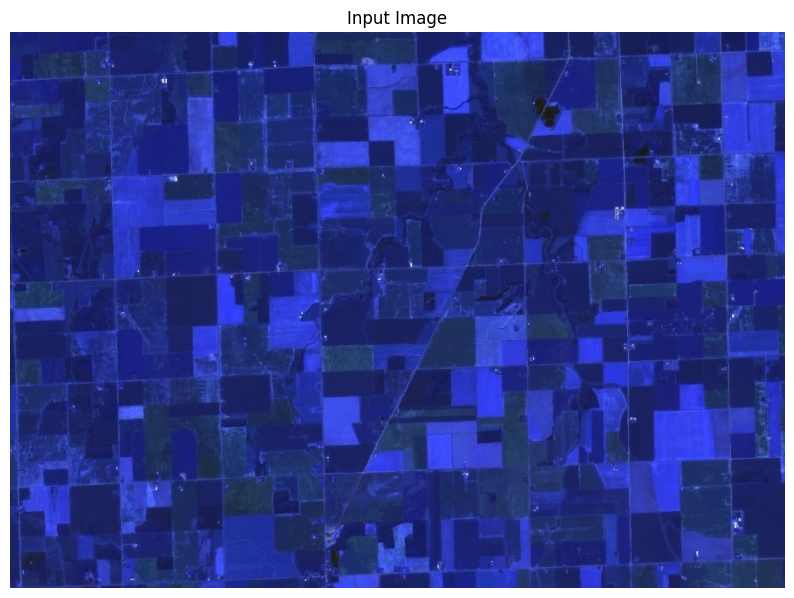

In [100]:
#loading the image
input_image_path= '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/2_3_11_cropped.jpg'
image = cv2.imread(input_image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

#Display the image
plt.figure(figsize=(10,10))
plt.imshow(image_rgb)
plt.title('Input Image')
plt.axis('off')
plt.show()

## GMM Part


In [57]:
# Reshaping the image for clustering
pixel_values = image_rgb.reshape(-1, 3)
'''
# Testing different numbers of clusters
n_components_range = range(1, 20)
log_likelihoods = []

for n_components in n_components_range:
    gmm = GMM(n_components=n_components, random_state=0)
    gmm.fit(pixel_values)
    log_likelihoods.append(gmm.score(pixel_values))  # Log-likelihood for each number of clusters

# Elbow Method graph
plt.figure(figsize=(8, 6))
plt.plot(n_components_range, log_likelihoods, marker='o')
plt.title("Elbow Method for Optimal Clusters")
plt.xlabel("Number of Clusters")
plt.ylabel("Log-Likelihood")
plt.grid()
'''

'\n# Testing different numbers of clusters\nn_components_range = range(1, 20)\nlog_likelihoods = []\n\nfor n_components in n_components_range:\n    gmm = GMM(n_components=n_components, random_state=0)\n    gmm.fit(pixel_values)\n    log_likelihoods.append(gmm.score(pixel_values))  # Log-likelihood for each number of clusters\n\n# Elbow Method graph\nplt.figure(figsize=(8, 6))\nplt.plot(n_components_range, log_likelihoods, marker=\'o\')\nplt.title("Elbow Method for Optimal Clusters")\nplt.xlabel("Number of Clusters")\nplt.ylabel("Log-Likelihood")\nplt.grid()\n'

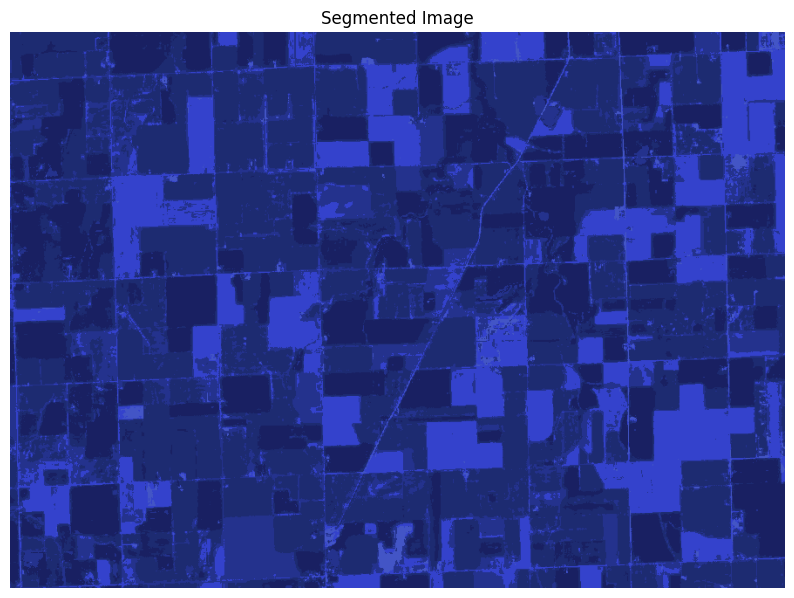

In [ ]:
# GMM for Color Grouping
h, w, c = image_rgb.shape
pixel_values = image_rgb.reshape(-1, 3)
n_components = 5 #Can be adjusted depending on the amount of colors present on the image
gmm = GMM(n_components=n_components, random_state=0)
gmm.fit(pixel_values)
gmm_labels = gmm.fit_predict(pixel_values)
segmented_image = gmm.means_[gmm_labels].reshape(h, w, c).astype(np.uint8)

# Displaying the image after GMM applycation
plt.figure(figsize=(10,10))
plt.imshow(segmented_image)
plt.title('Segmented Image')
plt.axis('off')
plt.show()

## SLICK Segmentation Part

In [12]:
n_segments = 500 #Can be adjusted depending on the amount of fields present on the image(approximetily)
slick_segments = slic(segmented_image, n_segments=n_segments, compactness=1, start_label=1)

NameError: name 'segmented_image' is not defined

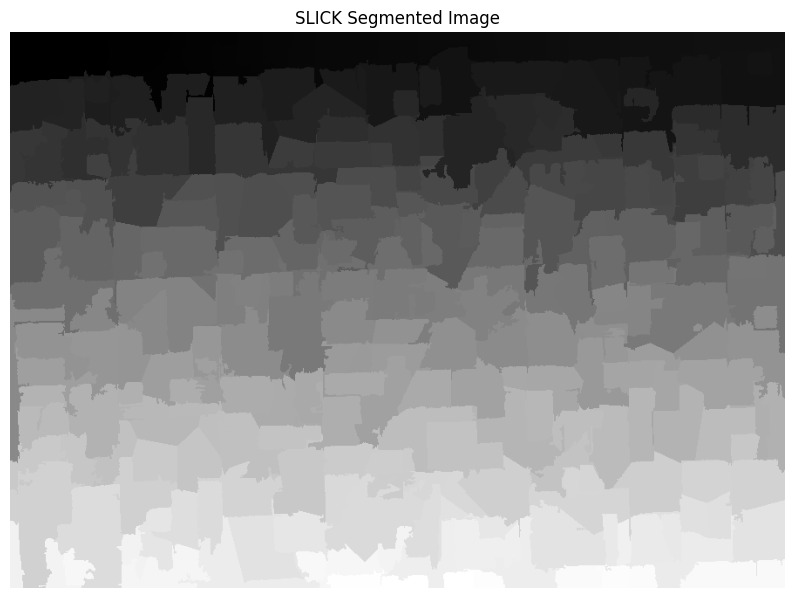

In [ ]:
# Displaying the image
plt.figure(figsize=(10,10))
plt.title('SLICK Segmented Image')
plt.imshow(slick_segments, cmap='grey')
plt.axis('off')
plt.show()

## Mark_boundries Part

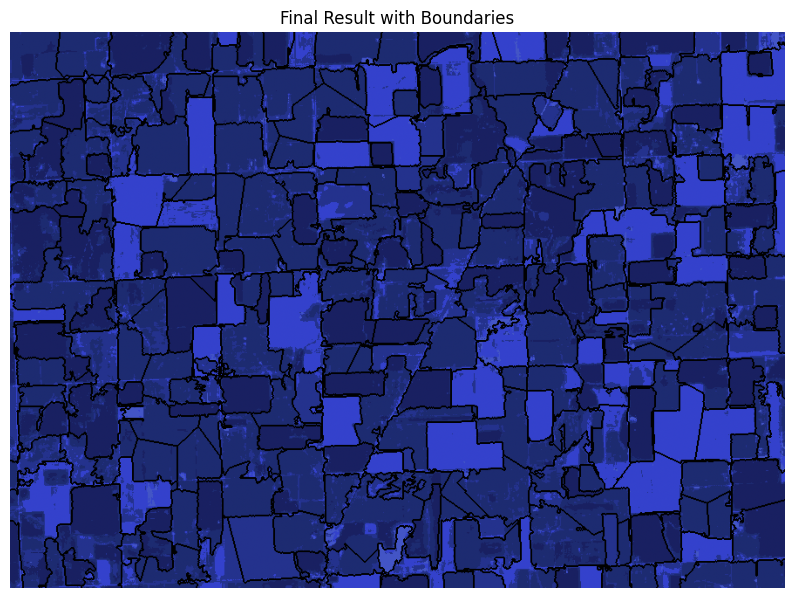

In [ ]:
image_with_boundaries = mark_boundaries(segmented_image, slick_segments, color=(0, 0, 0), mode='thick')

# Displaying the final result
plt.figure(figsize=(10, 10))
plt.title('Final Result with Boundaries')
plt.imshow(image_with_boundaries)
plt.axis('off')
plt.show()

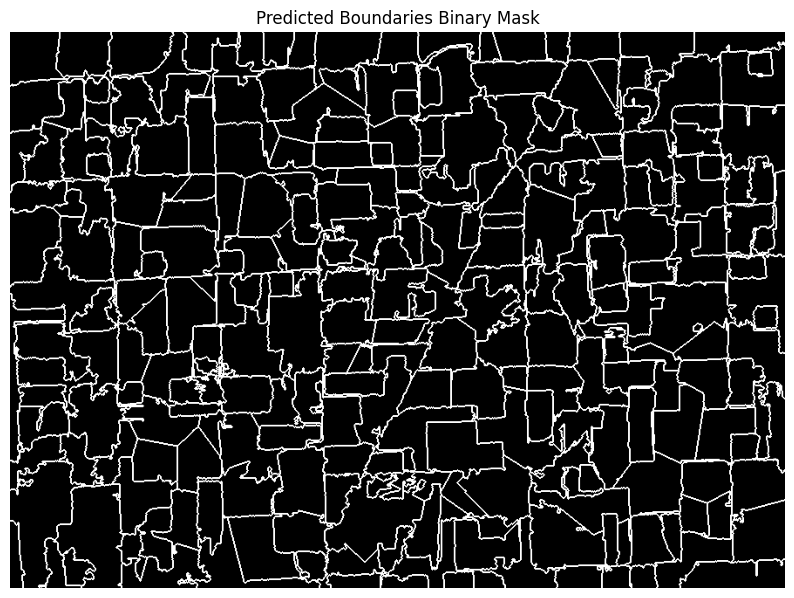

In [ ]:
# Converting image_with_boundaries to grayscale
image_boundaries_gray = cv2.cvtColor((image_with_boundaries * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)

# creating a binary mask for black boundaries
_, predicted_boundaries_binary = cv2.threshold(image_boundaries_gray, 1, 1, cv2.THRESH_BINARY_INV)

# Visualizing the binary boundaries
plt.figure(figsize=(10, 10))
plt.title("Predicted Boundaries Binary Mask")
plt.imshow(predicted_boundaries_binary, cmap='gray')
plt.axis('off')
plt.show()




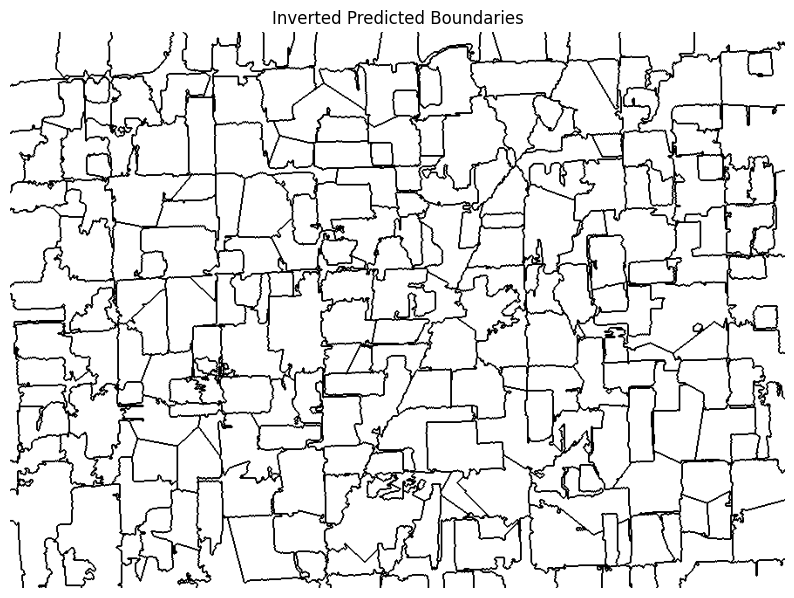

In [ ]:
# Inverting the predicted boundaries into black boundaries with white background
predicted_boundaries_inverted = 1 - predicted_boundaries_binary

# Visualizing the inverted predicted boundaries
plt.figure(figsize=(10, 10))
plt.title("Inverted Predicted Boundaries")
plt.imshow(predicted_boundaries_inverted, cmap='gray')
plt.axis('off')
plt.show()


IoU Score for Rectangular Segments Method: 0.85


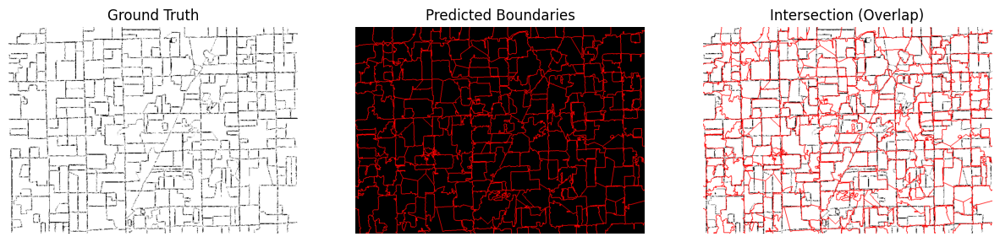

In [ ]:
# Loading the labeled image as grayscale
labeled_image_path = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/2_3_11_cropped_label.jpg'
ground_truth_mask = cv2.imread(labeled_image_path)

# Ensuring the ground truth mask is single-channel
if len(ground_truth_mask.shape) == 3:  # If it has 3 channels
    ground_truth_mask = cv2.cvtColor(ground_truth_mask, cv2.COLOR_BGR2GRAY)

# Resizing the ground truth mask to match the predicted boundaries dimensions
ground_truth_mask_resized = cv2.resize(ground_truth_mask, (predicted_boundaries_inverted.shape[1], predicted_boundaries_inverted.shape[0]))

# making both masks as binary
predicted_mask_binary =  (predicted_boundaries_inverted > 0).astype(np.uint8)
ground_truth_mask_binary = (ground_truth_mask_resized > 0).astype(np.uint8)

# Calculating Intersection and Union
intersection = np.logical_and(predicted_mask_binary, ground_truth_mask_binary)
union = np.logical_or(predicted_mask_binary, ground_truth_mask_binary)
iou_score = np.sum(intersection) / np.sum(union)

# IoU score
print(f"IoU Score for Rectangular Segments Method: {iou_score:.2f}")


'''
# Visualize the comparison
plt.figure(figsize=(15, 5))

# Ground Truth
plt.subplot(1, 3, 1)
plt.title("Ground Truth")
plt.imshow(ground_truth_mask_binary, cmap='gray')
plt.axis('off')

# Predicted Boundaries
plt.subplot(1, 3, 2)
plt.title("Predicted Boundaries")
plt.imshow(predicted_mask_binary, cmap='gray')
plt.axis('off')

# Intersection
plt.subplot(1, 3, 3)
plt.title("Intersection (Overlap)")
plt.imshow(intersection, cmap='gray')
plt.axis('off')

plt.show()
'''
predicted_mask_binary_inverted = 1 - predicted_mask_binary

# Visualize the comparison
plt.figure(figsize=(15, 5))

# Ground Truth
plt.subplot(1, 3, 1)
plt.title("Ground Truth")
plt.imshow(ground_truth_mask_binary, cmap='gray')
plt.axis('off')

# Predicted Boundaries
plt.subplot(1, 3, 2)
plt.title("Predicted Boundaries")

# Create an RGB image for predicted boundaries
predicted_boundaries_rgb = np.zeros((predicted_mask_binary.shape[0], predicted_mask_binary.shape[1], 3), dtype=np.uint8)

# Set the red channel where predicted_mask_binary is 0 (boundary pixels)
predicted_boundaries_rgb[predicted_mask_binary == 0] = [255, 0, 0]  # Red color

plt.imshow(predicted_boundaries_rgb)
plt.axis('off')

# Intersection
plt.subplot(1, 3, 3)
plt.title("Intersection (Overlap)")

# Create an RGB image of the ground truth mask
ground_truth_rgb = np.zeros((ground_truth_mask_binary.shape[0], ground_truth_mask_binary.shape[1], 3), dtype=np.uint8)
ground_truth_rgb[ground_truth_mask_binary == 1] = [255, 255, 255]  # White color for ground truth

# Overlay the predicted boundaries in red on the ground truth
intersection_overlay = ground_truth_rgb.copy()
intersection_overlay[predicted_mask_binary == 0] = [255, 0, 0]  # Red color for predicted boundaries

plt.imshow(intersection_overlay)
plt.axis('off')

plt.show()


IoU Score for Rectangular Segments Method: 0.85


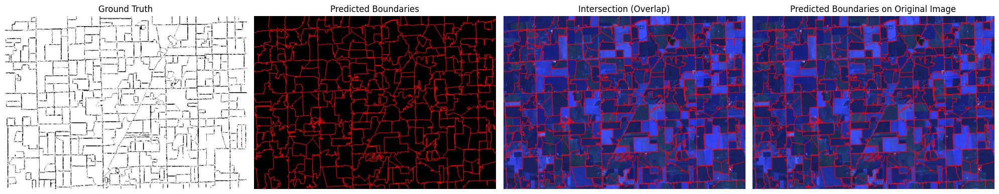

In [ ]:
# Loading the labeled image as grayscale
labeled_image_path = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/2_3_11_cropped_label.jpg'
ground_truth_mask = cv2.imread(labeled_image_path)

# Ensuring the ground truth mask is single-channel
if len(ground_truth_mask.shape) == 3:
    ground_truth_mask = cv2.cvtColor(ground_truth_mask, cv2.COLOR_BGR2GRAY)

# Resizing the ground truth mask to match the predicted boundaries dimensions
ground_truth_mask_resized = cv2.resize(ground_truth_mask, (predicted_boundaries_inverted.shape[1], predicted_boundaries_inverted.shape[0]))

# Making both masks binary
predicted_mask_binary = (predicted_boundaries_inverted > 0).astype(np.uint8)
ground_truth_mask_binary = (ground_truth_mask_resized > 0).astype(np.uint8)

# Calculating Intersection and Union
intersection = np.logical_and(predicted_mask_binary, ground_truth_mask_binary)
union = np.logical_or(predicted_mask_binary, ground_truth_mask_binary)
iou_score = np.sum(intersection) / np.sum(union)

# IoU score
print(f"IoU Score for Rectangular Segments Method: {iou_score:.2f}")

# Predicted boundaries overlay
predicted_mask_binary_inverted = 1 - predicted_mask_binary

# Load the original image
original_image_path = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/2_3_11_cropped.jpg'
original_image = cv2.imread(original_image_path)
original_image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)

# Overlay predicted boundaries on the original image
overlay_image = original_image_rgb.copy()
overlay_image[predicted_mask_binary == 0] = [255, 0, 0]  # Red color for predicted boundaries

# Visualize the comparison
plt.figure(figsize=(20, 10))

# Ground Truth
plt.subplot(1, 4, 1)
plt.title("Ground Truth")
plt.imshow(ground_truth_mask_binary, cmap='gray')
plt.axis('off')

# Predicted Boundaries
plt.subplot(1, 4, 2)
plt.title("Predicted Boundaries")
predicted_boundaries_rgb = np.zeros((predicted_mask_binary.shape[0], predicted_mask_binary.shape[1], 3), dtype=np.uint8)
predicted_boundaries_rgb[predicted_mask_binary == 0] = [255, 0, 0]  # Red color
plt.imshow(predicted_boundaries_rgb)
plt.axis('off')

# Intersection
plt.subplot(1, 4, 3)
plt.title("Intersection (Overlap)")
intersection_overlay = original_image_rgb.copy()
intersection_overlay[predicted_mask_binary == 0] = [255, 0, 0]  # Red for predicted boundaries
plt.imshow(intersection_overlay)
plt.axis('off')

# Predicted Boundaries on Original Image
plt.subplot(1, 4, 4)
plt.title("Predicted Boundaries on Original Image")
plt.imshow(overlay_image)
plt.axis('off')

plt.tight_layout()
plt.show()



In [ ]:
# Save the resulting overlay image
output_path = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/results/predicted_boundaries_overlay.jpg'
cv2.imwrite(output_path, cv2.cvtColor(overlay_image, cv2.COLOR_RGB2BGR))
print(f"Overlay image saved to: {output_path}")

Overlay image saved to: /content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/results/predicted_boundaries_overlay.jpg


# AUTOMATION PROCESS FOR SEGMENT NUMBER CHOICE FOR VARIOUS ALTITUDE



Processing 1(300).jpg...


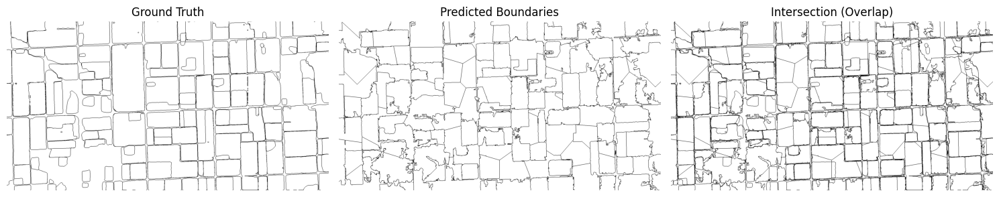

Processing 2(300).jpg...


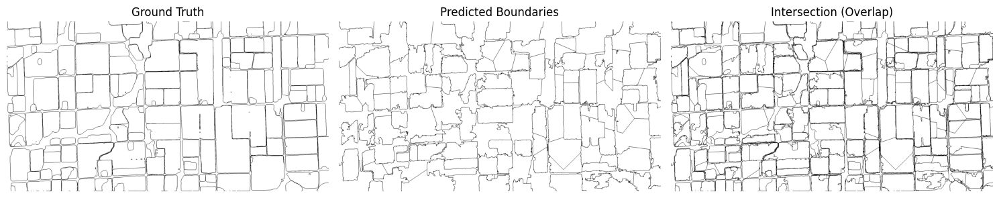

Processing 3(300).jpg...


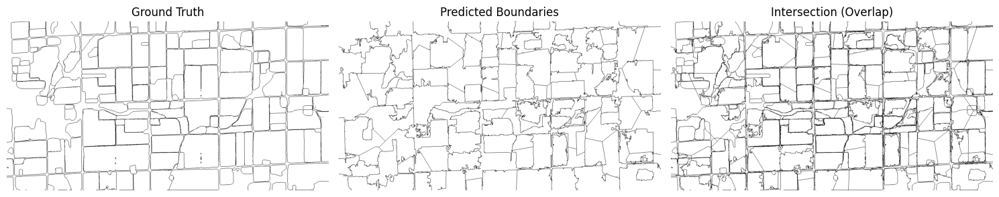

Processing 4(300).jpg...


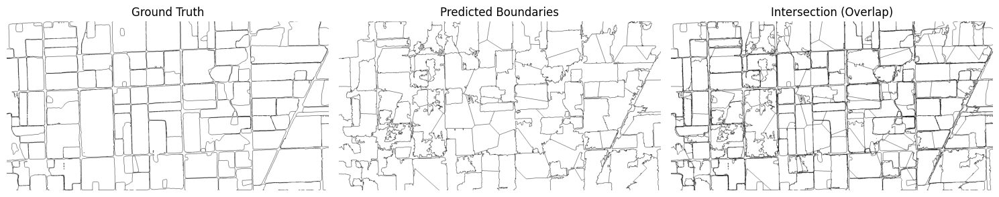

Processing 5(300).jpg...


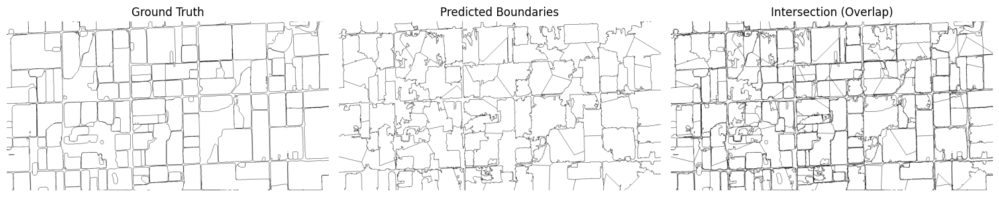

Processing 6(300).jpg...


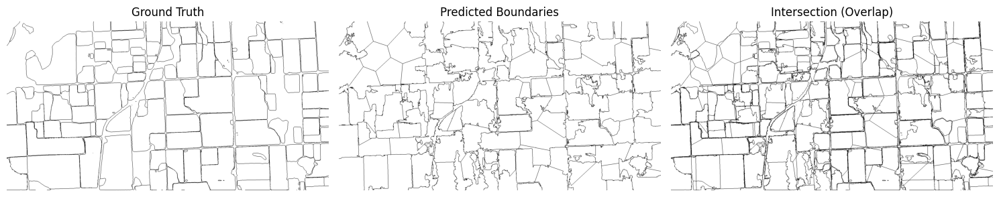

Processing 7(300).jpg...


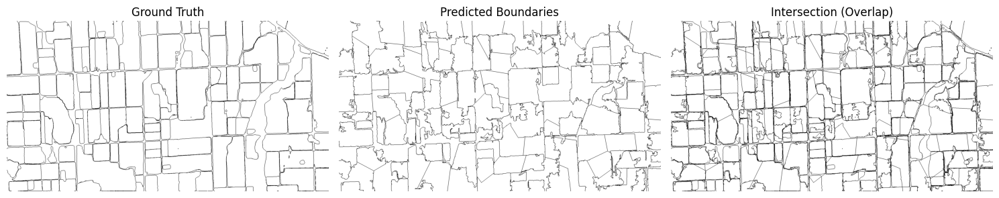

Processing 8(300).jpg...


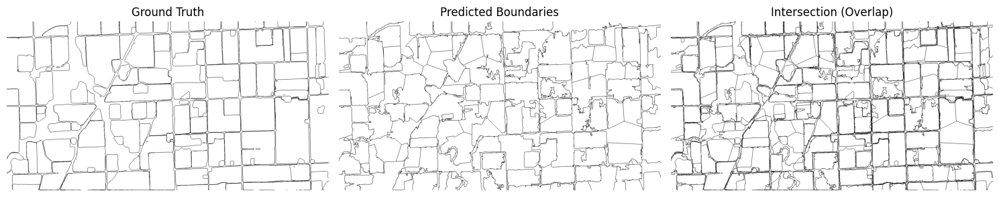

Processing 9(300).jpg...


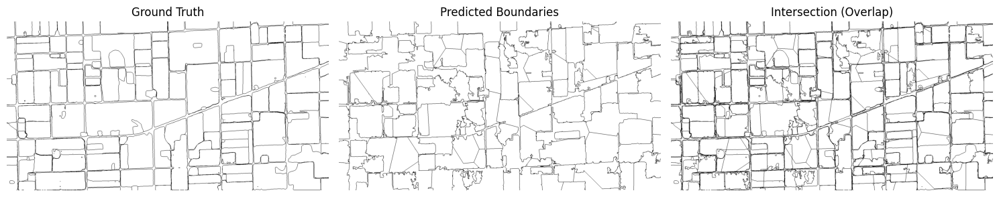

Processing 10(300).jpg...


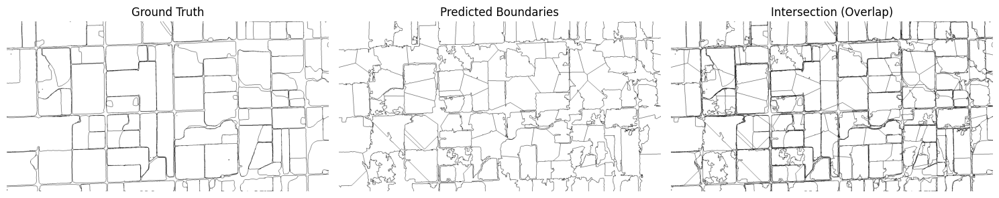


IoU Scores for all images:
1(300).jpg: 0.92
2(300).jpg: 0.92
3(300).jpg: 0.92
4(300).jpg: 0.92
5(300).jpg: 0.92
6(300).jpg: 0.92
7(300).jpg: 0.92
8(300).jpg: 0.91
9(300).jpg: 0.91
10(300).jpg: 0.92


In [ ]:
def process_image(image_path, label_path, n_segments=235, n_clusters=5):
    """Process a single image to calculate IoU and visualize."""
    # Loading the raw image
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, _ = image_rgb.shape

    # Loading the labeled image
    ground_truth_mask = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
    ground_truth_mask_resized = cv2.resize(ground_truth_mask, (w, h))

    # GMM clustering with 5 clusters (elbow method shows it as best number)
    pixel_values = image_rgb.reshape(-1, 3)
    gmm = GMM(n_components=n_clusters, random_state=0)
    gmm_labels = gmm.fit_predict(pixel_values)
    segmented_image = gmm.means_[gmm_labels].reshape(h, w, 3).astype(np.uint8)

    # SLIC segmentation
    slic_segments = slic(segmented_image, n_segments=n_segments, compactness=1, start_label=1)

    # Extracting boundaries from SLIC
    image_with_boundaries = mark_boundaries(segmented_image, slic_segments, color=(0, 0, 0), mode='thick')
    image_boundaries_gray = cv2.cvtColor((image_with_boundaries * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
    _, predicted_boundaries_binary = cv2.threshold(image_boundaries_gray, 1, 1, cv2.THRESH_BINARY_INV)
    predicted_boundaries_inverted = 1 - predicted_boundaries_binary

    # making both masks aa binary
    predicted_mask_binary = (predicted_boundaries_inverted > 0).astype(np.uint8)
    ground_truth_mask_binary = (ground_truth_mask_resized > 0).astype(np.uint8)

    #  IoU
    intersection = np.logical_and(predicted_mask_binary, ground_truth_mask_binary)
    union = np.logical_or(predicted_mask_binary, ground_truth_mask_binary)
    iou_score = np.sum(intersection) / np.sum(union)

    # Visualizing the comparison
    plt.figure(figsize=(15, 5))

    # Ground Truth
    plt.subplot(1, 3, 1)
    plt.title("Ground Truth")
    plt.imshow(ground_truth_mask_binary, cmap='gray')
    plt.axis('off')

    # Predicted Boundaries
    plt.subplot(1, 3, 2)
    plt.title("Predicted Boundaries")
    plt.imshow(predicted_mask_binary, cmap='gray')
    plt.axis('off')

    # Intersection
    plt.subplot(1, 3, 3)
    plt.title("Intersection (Overlap)")
    plt.imshow(intersection, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    return iou_score

# Paths
image_folder = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/300/raw'
label_folder = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/300/labeled '

# Processing all images
iou_scores = []
for filename in os.listdir(image_folder):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(image_folder, filename)
        label_path = os.path.join(label_folder, f"{os.path.splitext(filename)[0]}_labeled.png")

        if os.path.exists(label_path):
            print(f"Processing {filename}...")
            iou_score = process_image(image_path, label_path, n_segments=235, n_clusters=5)
            iou_scores.append((filename, iou_score))
        else:
            print(f"Warning: No matching labeled image for {filename}")

# IoU results
print("\nIoU Scores for all images:")
for filename, iou_score in iou_scores:
    print(f"{filename}: {iou_score:.2f}")



Processing 1(500).jpg...


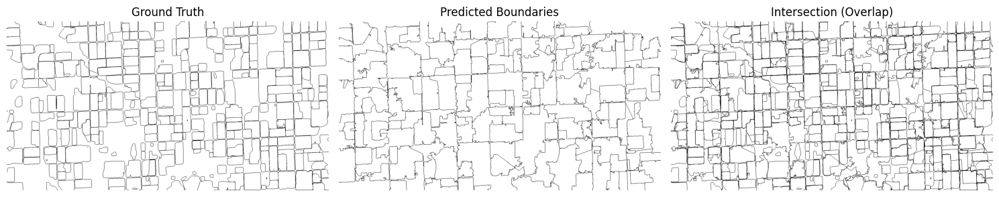

Processing 2(500).jpg...


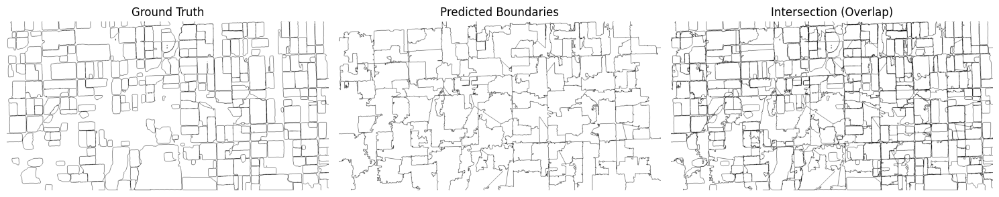

Processing 3(500).jpg...


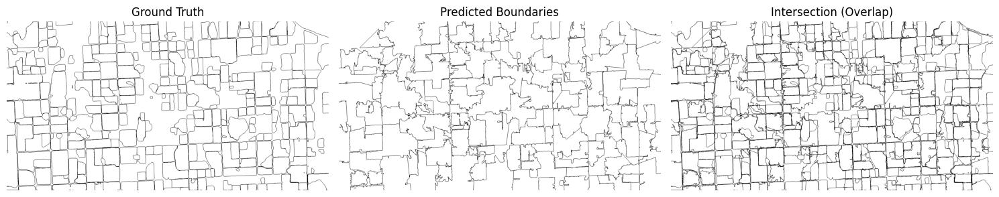

Processing 4(500).jpg...


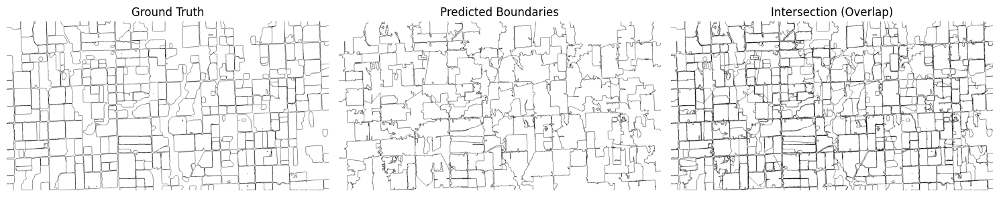

Processing 5(500).jpg...


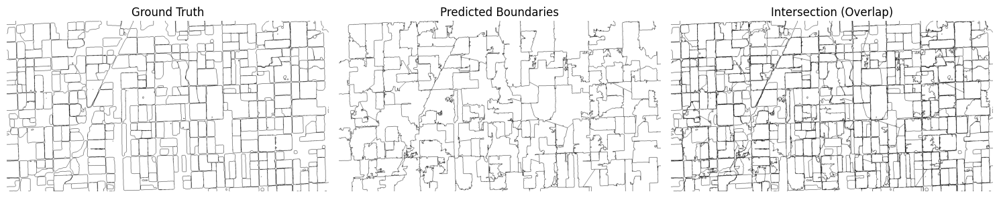

Processing 6(500).jpg...


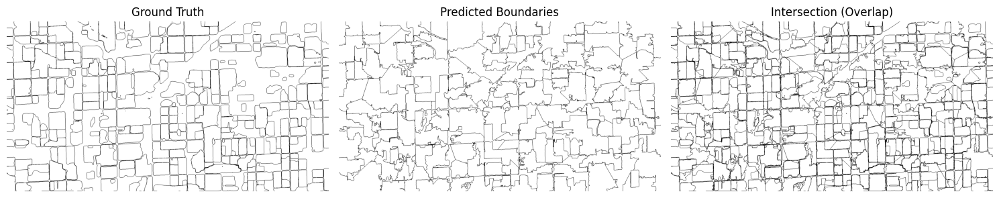

Processing 7(500).jpg...


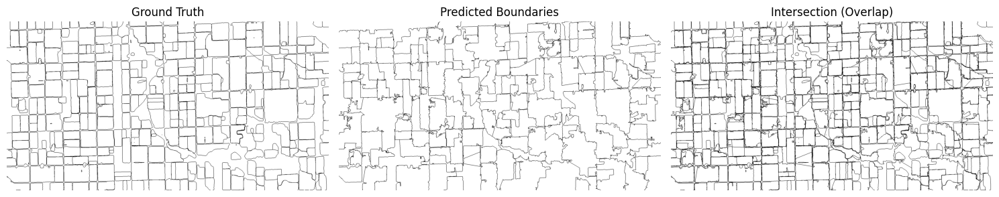

Processing 8(500).jpg...


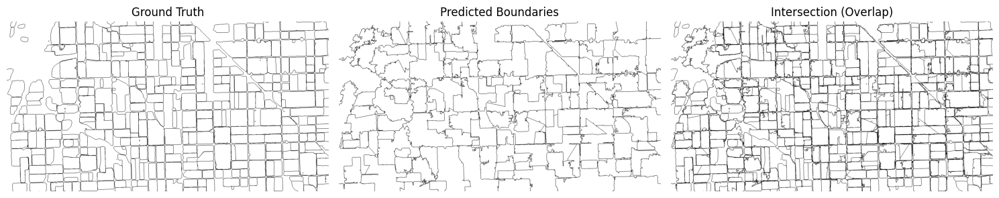

Processing 9(500).jpg...


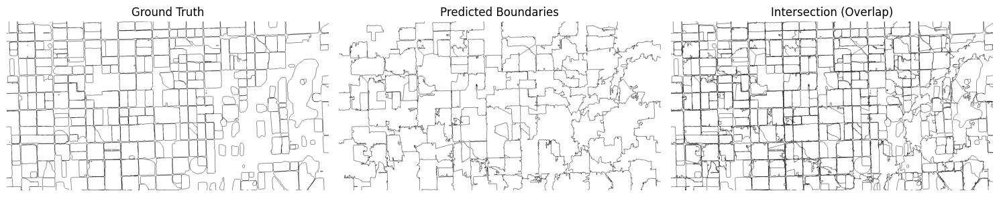

Processing 10(500).jpg...


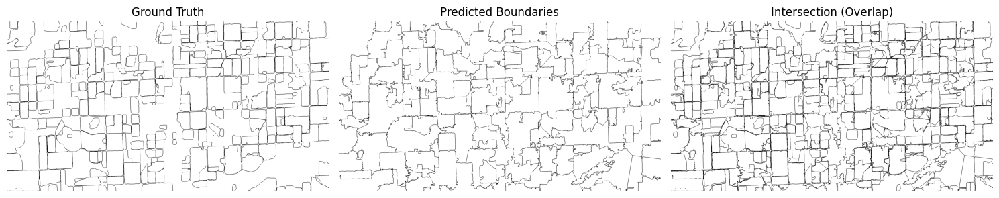


IoU Scores for all images:
1(500).jpg: 0.91
2(500).jpg: 0.92
3(500).jpg: 0.91
4(500).jpg: 0.91
5(500).jpg: 0.91
6(500).jpg: 0.91
7(500).jpg: 0.91
8(500).jpg: 0.90
9(500).jpg: 0.91
10(500).jpg: 0.92


In [ ]:
''' SAME BUT WITH DIFFERENT ALTITUDE'''

def process_image(image_path, label_path, n_segments=404, n_clusters=5):
    """Process a single image to calculate IoU and visualize."""

    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, _ = image_rgb.shape


    ground_truth_mask = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
    ground_truth_mask_resized = cv2.resize(ground_truth_mask, (w, h))


    pixel_values = image_rgb.reshape(-1, 3)
    gmm = GMM(n_components=n_clusters, random_state=0)
    gmm_labels = gmm.fit_predict(pixel_values)
    segmented_image = gmm.means_[gmm_labels].reshape(h, w, 3).astype(np.uint8)


    slic_segments = slic(segmented_image, n_segments=n_segments, compactness=1, start_label=1)


    image_with_boundaries = mark_boundaries(segmented_image, slic_segments, color=(0, 0, 0), mode='thick')
    image_boundaries_gray = cv2.cvtColor((image_with_boundaries * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
    _, predicted_boundaries_binary = cv2.threshold(image_boundaries_gray, 1, 1, cv2.THRESH_BINARY_INV)
    predicted_boundaries_inverted = 1 - predicted_boundaries_binary


    predicted_mask_binary = (predicted_boundaries_inverted > 0).astype(np.uint8)
    ground_truth_mask_binary = (ground_truth_mask_resized > 0).astype(np.uint8)


    intersection = np.logical_and(predicted_mask_binary, ground_truth_mask_binary)
    union = np.logical_or(predicted_mask_binary, ground_truth_mask_binary)
    iou_score = np.sum(intersection) / np.sum(union)


    plt.figure(figsize=(15, 5))


    plt.subplot(1, 3, 1)
    plt.title("Ground Truth")
    plt.imshow(ground_truth_mask_binary, cmap='gray')
    plt.axis('off')


    plt.subplot(1, 3, 2)
    plt.title("Predicted Boundaries")
    plt.imshow(predicted_mask_binary, cmap='gray')
    plt.axis('off')


    plt.subplot(1, 3, 3)
    plt.title("Intersection (Overlap)")
    plt.imshow(intersection, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    return iou_score


image_folder = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/500/raw'
label_folder = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/500/labeled '


iou_scores = []
for filename in os.listdir(image_folder):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(image_folder, filename)
        label_path = os.path.join(label_folder, f"{os.path.splitext(filename)[0]}_labeled.png")

        if os.path.exists(label_path):
            print(f"Processing {filename}...")
            iou_score = process_image(image_path, label_path, n_segments=235, n_clusters=5)
            iou_scores.append((filename, iou_score))
        else:
            print(f"Warning: No matching labeled image for {filename}")


print("\nIoU Scores for all images:")
for filename, iou_score in iou_scores:
    print(f"{filename}: {iou_score:.2f}")

### NO GMM

Processing 1(300).jpg...


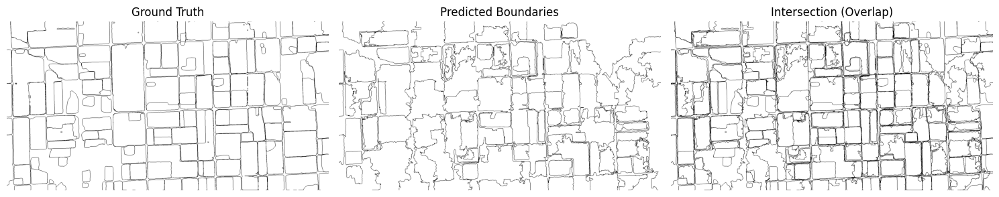

Processing 2(300).jpg...


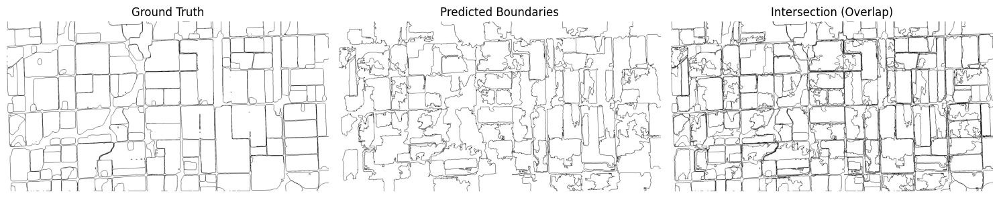

Processing 3(300).jpg...


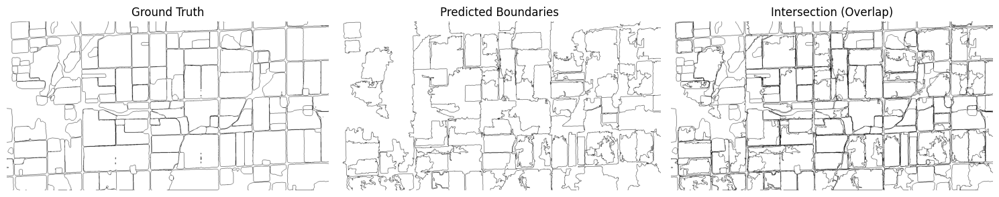

Processing 4(300).jpg...


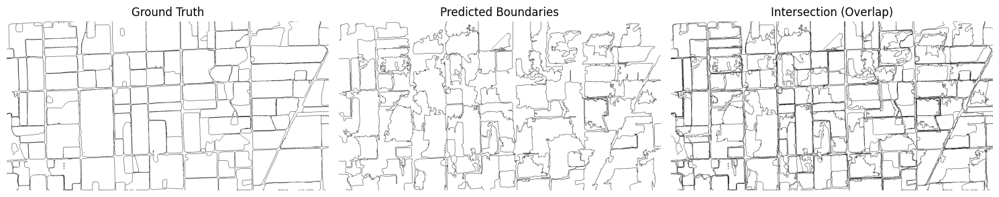

Processing 5(300).jpg...


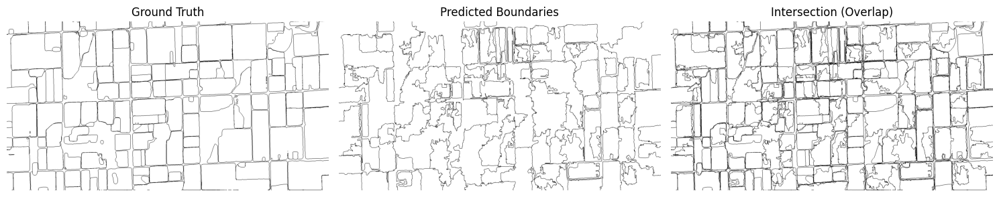

Processing 6(300).jpg...


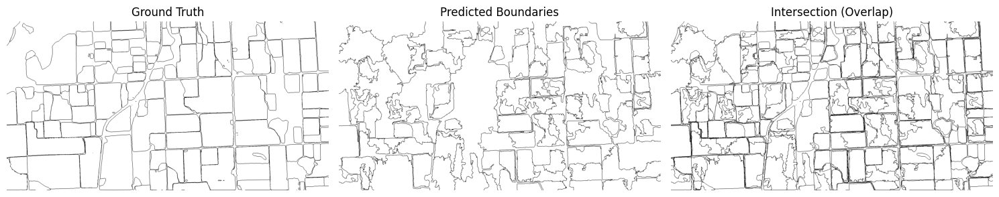

Processing 7(300).jpg...


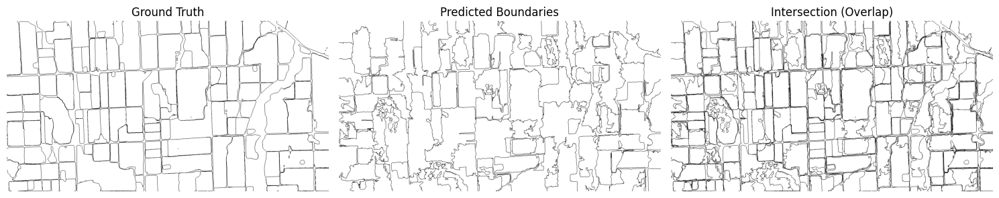

Processing 8(300).jpg...


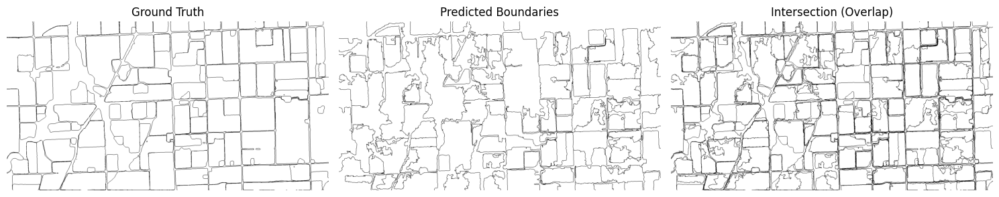

Processing 9(300).jpg...


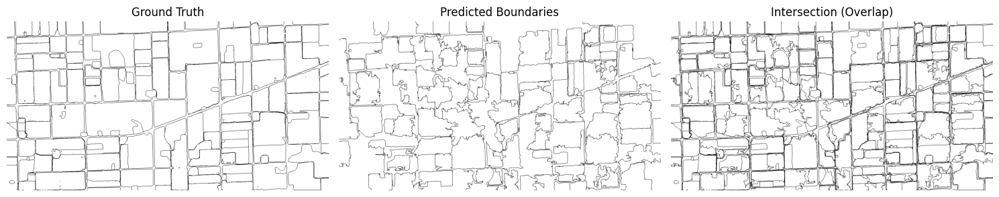

Processing 10(300).jpg...


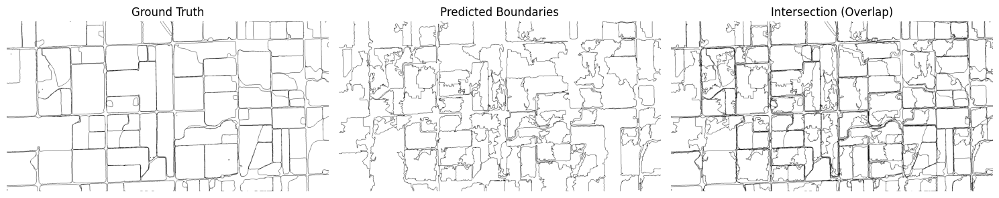


IoU Scores for all images:
1(300).jpg: 0.91
2(300).jpg: 0.90
3(300).jpg: 0.91
4(300).jpg: 0.91
5(300).jpg: 0.91
6(300).jpg: 0.91
7(300).jpg: 0.91
8(300).jpg: 0.91
9(300).jpg: 0.91
10(300).jpg: 0.91


In [ ]:

from skimage.segmentation import slic, mark_boundaries

def process_image(image_path, label_path, n_segments=235):
    """Process a single image to calculate IoU and visualize."""
    # Load the raw image
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, _ = image_rgb.shape

    # Load the labeled image
    ground_truth_mask = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
    ground_truth_mask_resized = cv2.resize(ground_truth_mask, (w, h))

    # Apply SLIC segmentation directly on the original image
    slic_segments = slic(image_rgb, n_segments=n_segments, compactness=1, start_label=1)

    # Extract boundaries from SLIC
    image_with_boundaries = mark_boundaries(image_rgb, slic_segments, color=(0, 0, 0), mode='thick')
    image_boundaries_gray = cv2.cvtColor((image_with_boundaries * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
    _, predicted_boundaries_binary = cv2.threshold(image_boundaries_gray, 1, 1, cv2.THRESH_BINARY_INV)
    predicted_boundaries_inverted = 1 - predicted_boundaries_binary

    # Ensure both masks are binary
    predicted_mask_binary = (predicted_boundaries_inverted > 0).astype(np.uint8)
    ground_truth_mask_binary = (ground_truth_mask_resized > 0).astype(np.uint8)

    # Calculate IoU
    intersection = np.logical_and(predicted_mask_binary, ground_truth_mask_binary)
    union = np.logical_or(predicted_mask_binary, ground_truth_mask_binary)
    iou_score = np.sum(intersection) / np.sum(union)

    # Visualize the comparison
    plt.figure(figsize=(15, 5))

    # Ground Truth
    plt.subplot(1, 3, 1)
    plt.title("Ground Truth")
    plt.imshow(ground_truth_mask_binary, cmap='gray')
    plt.axis('off')

    # Predicted Boundaries
    plt.subplot(1, 3, 2)
    plt.title("Predicted Boundaries")
    plt.imshow(predicted_mask_binary, cmap='gray')
    plt.axis('off')

    # Intersection
    plt.subplot(1, 3, 3)
    plt.title("Intersection (Overlap)")
    plt.imshow(intersection, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    return iou_score

# Paths
image_folder = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/300/raw'
label_folder = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/300/labeled '

# Process all images
iou_scores = []
for filename in os.listdir(image_folder):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(image_folder, filename)
        label_path = os.path.join(label_folder, f"{os.path.splitext(filename)[0]}_labeled.png")

        if os.path.exists(label_path):
            print(f"Processing {filename}...")
            iou_score = process_image(image_path, label_path, n_segments=235)
            iou_scores.append((filename, iou_score))
        else:
            print(f"Warning: No matching labeled image for {filename}")

# Print IoU results
print("\nIoU Scores for all images:")
for filename, iou_score in iou_scores:
    print(f"{filename}: {iou_score:.2f}")


Processing 1(300).jpg...


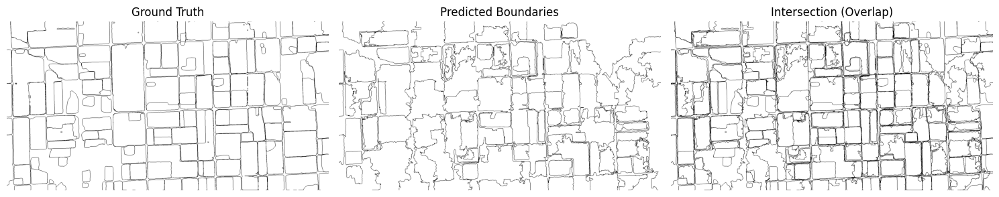

Processing 2(300).jpg...


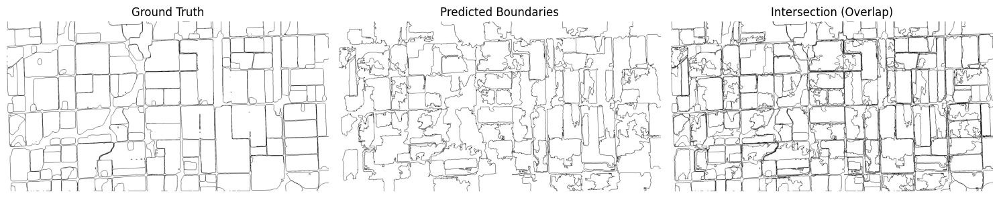

Processing 3(300).jpg...


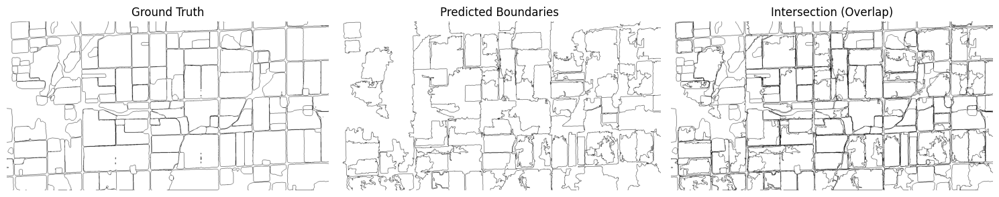

Processing 4(300).jpg...


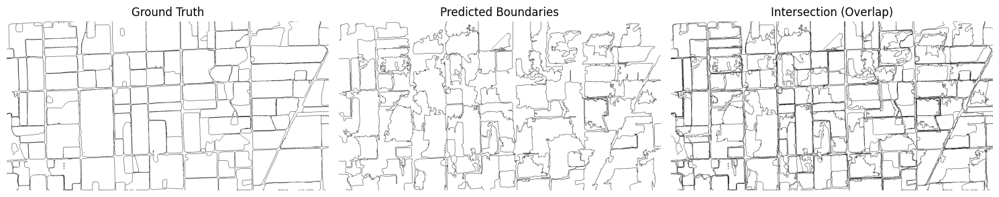

Processing 5(300).jpg...


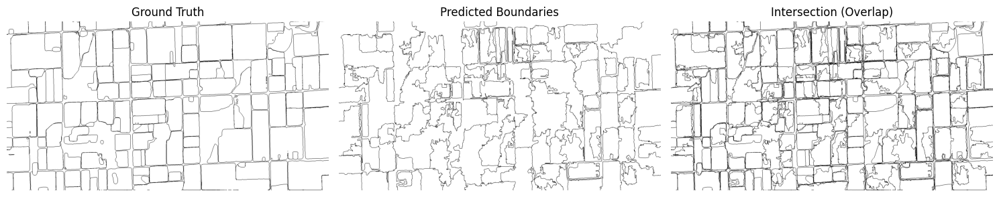

Processing 6(300).jpg...


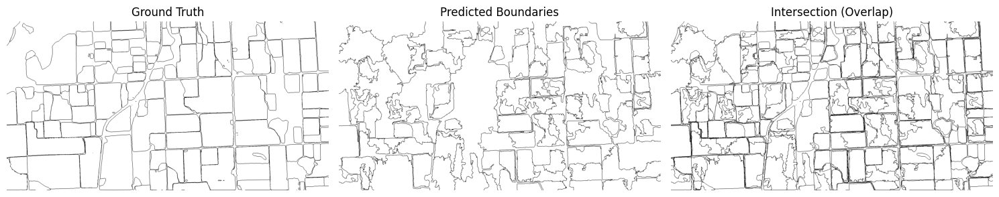

Processing 7(300).jpg...


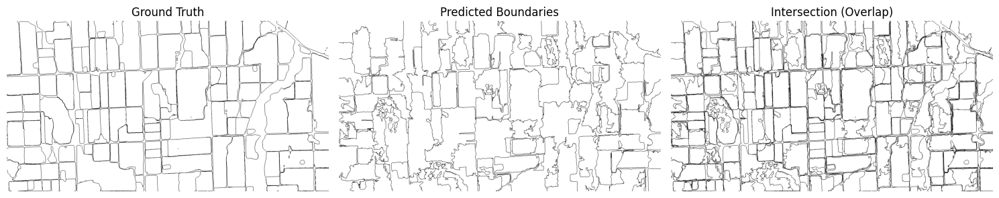

Processing 8(300).jpg...


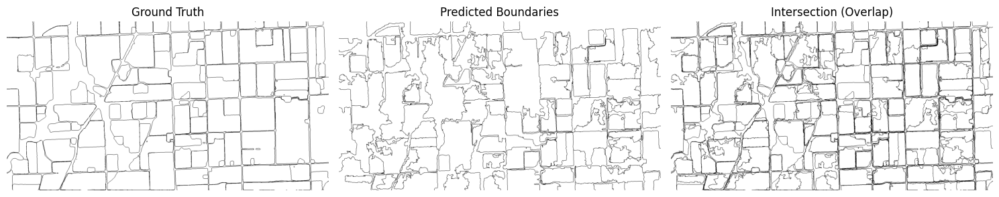

Processing 9(300).jpg...


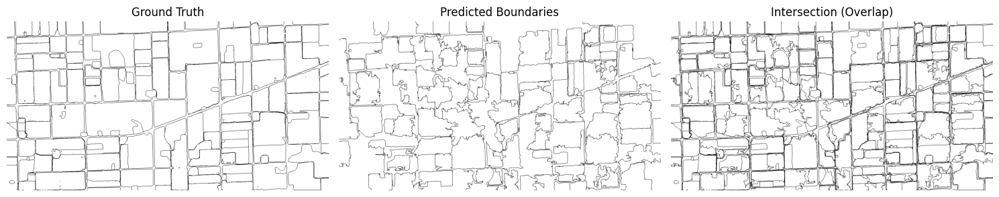

Processing 10(300).jpg...


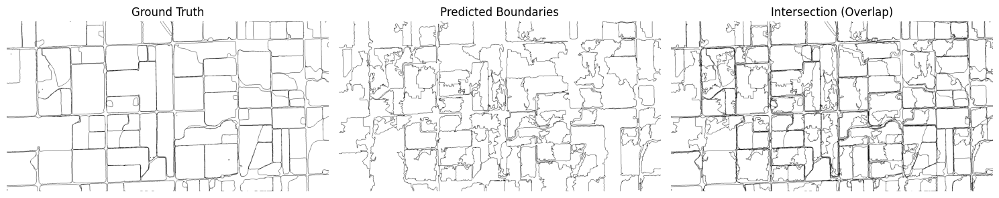


IoU Scores for all images:
1(300).jpg: 0.91
2(300).jpg: 0.90
3(300).jpg: 0.91
4(300).jpg: 0.91
5(300).jpg: 0.91
6(300).jpg: 0.91
7(300).jpg: 0.91
8(300).jpg: 0.91
9(300).jpg: 0.91
10(300).jpg: 0.91


In [ ]:
def process_image(image_path, label_path, n_segments=235):
    """Process a single image to calculate IoU and visualize."""
    # Load the raw image
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, _ = image_rgb.shape

    # Load the labeled image
    ground_truth_mask = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
    ground_truth_mask_resized = cv2.resize(ground_truth_mask, (w, h))

    # Apply SLIC segmentation directly on the original image
    slic_segments = slic(image_rgb, n_segments=n_segments, compactness=1, start_label=1)

    # Extract boundaries from SLIC
    image_with_boundaries = mark_boundaries(image_rgb, slic_segments, color=(0, 0, 0), mode='thick')
    image_boundaries_gray = cv2.cvtColor((image_with_boundaries * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
    _, predicted_boundaries_binary = cv2.threshold(image_boundaries_gray, 1, 1, cv2.THRESH_BINARY_INV)
    predicted_boundaries_inverted = 1 - predicted_boundaries_binary

    # Ensure both masks are binary
    predicted_mask_binary = (predicted_boundaries_inverted > 0).astype(np.uint8)
    ground_truth_mask_binary = (ground_truth_mask_resized > 0).astype(np.uint8)

    # Calculate IoU
    intersection = np.logical_and(predicted_mask_binary, ground_truth_mask_binary)
    union = np.logical_or(predicted_mask_binary, ground_truth_mask_binary)
    iou_score = np.sum(intersection) / np.sum(union)

    # Visualize the comparison
    plt.figure(figsize=(15, 5))

    # Ground Truth
    plt.subplot(1, 3, 1)
    plt.title("Ground Truth")
    plt.imshow(ground_truth_mask_binary, cmap='gray')
    plt.axis('off')

    # Predicted Boundaries
    plt.subplot(1, 3, 2)
    plt.title("Predicted Boundaries")
    plt.imshow(predicted_mask_binary, cmap='gray')
    plt.axis('off')

    # Intersection
    plt.subplot(1, 3, 3)
    plt.title("Intersection (Overlap)")
    plt.imshow(intersection, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    return iou_score

# Paths
image_folder = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/300/raw'
label_folder = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/300/labeled '

# Process all images
iou_scores = []
for filename in os.listdir(image_folder):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(image_folder, filename)
        label_path = os.path.join(label_folder, f"{os.path.splitext(filename)[0]}_labeled.png")

        if os.path.exists(label_path):
            print(f"Processing {filename}...")
            iou_score = process_image(image_path, label_path, n_segments=235)
            iou_scores.append((filename, iou_score))
        else:
            print(f"Warning: No matching labeled image for {filename}")

# Print IoU results
print("\nIoU Scores for all images:")
for filename, iou_score in iou_scores:
    print(f"{filename}: {iou_score:.2f}")

# FITTING SEGEMNTS INTO MARK BOUNDRIES

Processing 1(300).jpg...


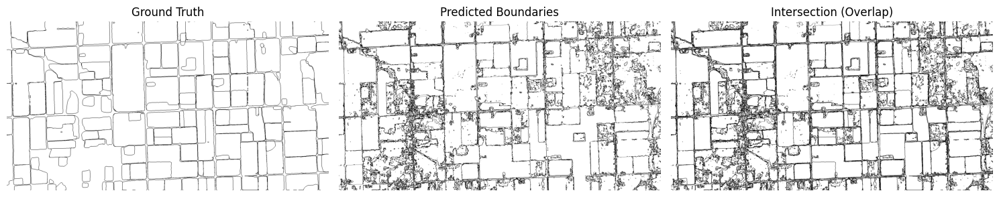

Processing 2(300).jpg...


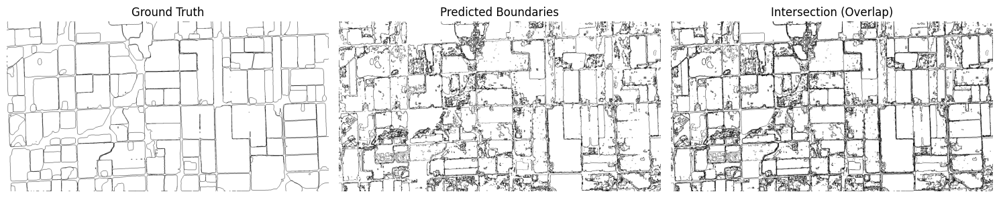

Processing 3(300).jpg...


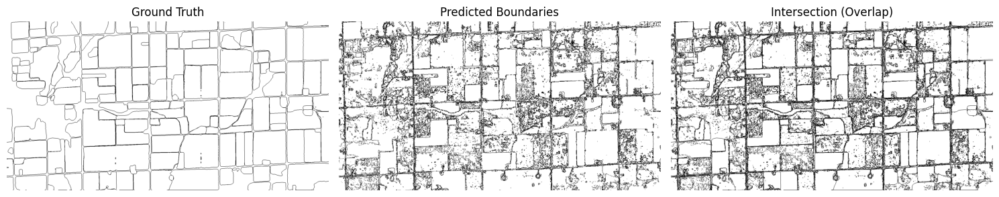

Processing 4(300).jpg...


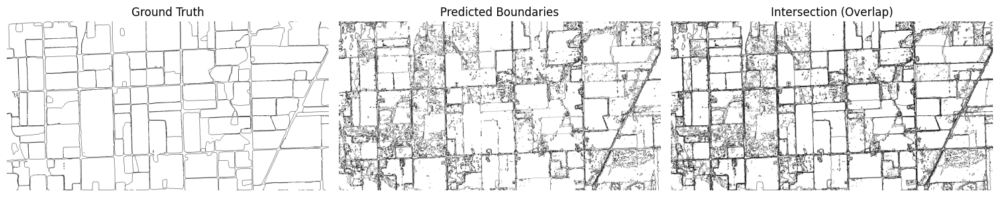

Processing 5(300).jpg...


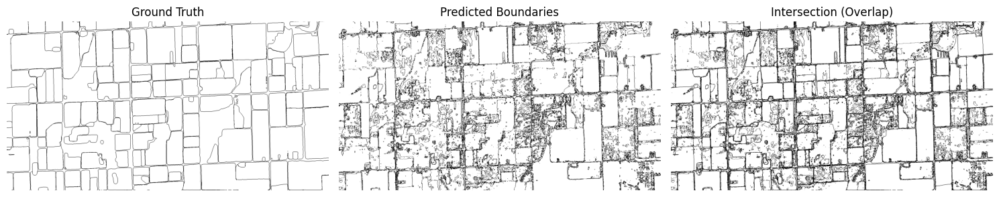

Processing 6(300).jpg...


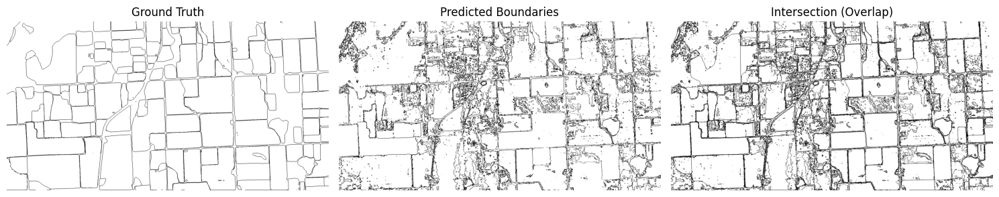

Processing 7(300).jpg...


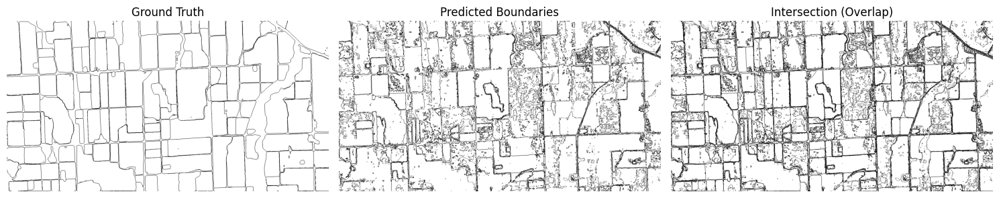

Processing 8(300).jpg...


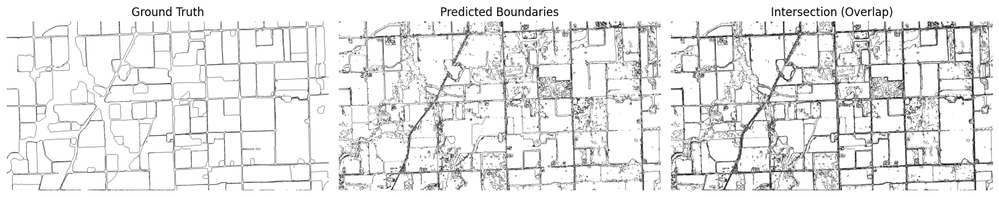

Processing 9(300).jpg...


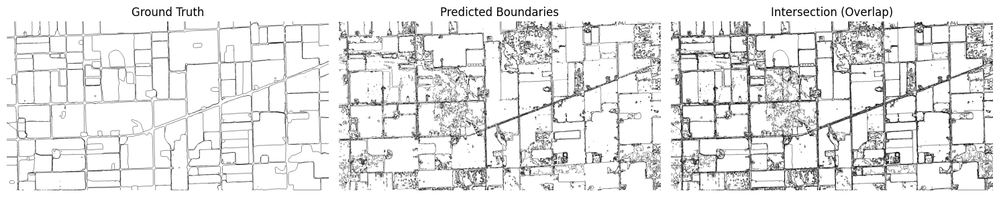

Processing 10(300).jpg...


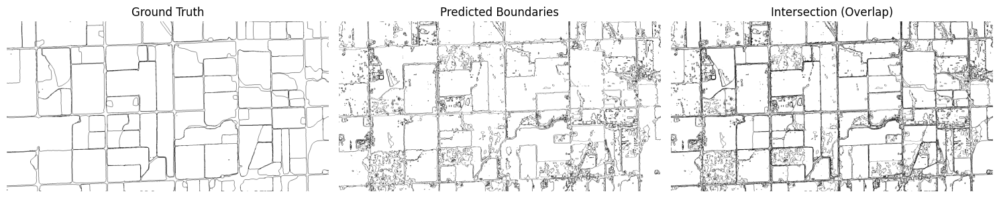


IoU Scores for all images:
1(300).jpg: 0.85
2(300).jpg: 0.85
3(300).jpg: 0.82
4(300).jpg: 0.86
5(300).jpg: 0.85
6(300).jpg: 0.86
7(300).jpg: 0.86
8(300).jpg: 0.87
9(300).jpg: 0.86
10(300).jpg: 0.89


In [ ]:
def process_image_with_gmm(image_path, label_path, n_components=5):
    """Process a single image with GMM and find boundaries to calculate IoU."""
    # Load the raw image
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, c = image_rgb.shape

    # Load and preprocess the labeled ground truth mask
    ground_truth_mask = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
    ground_truth_mask_resized = cv2.resize(ground_truth_mask, (w, h))

    # Reshape and apply GMM clustering
    pixel_values = image_rgb.reshape(-1, 3)
    gmm = GMM(n_components=n_components, random_state=0)
    gmm_labels = gmm.fit_predict(pixel_values)
    segmented_image = gmm_labels.reshape(h, w)

    # Find boundaries in the GMM-segmented image
    boundaries = find_boundaries(segmented_image, mode='outer').astype(np.uint8)

    # Ensure both masks are binary
    predicted_mask_binary = 1 - (boundaries > 0).astype(np.uint8)
    ground_truth_mask_binary = (ground_truth_mask_resized > 0).astype(np.uint8)

    # Calculate Intersection and Union
    intersection = np.logical_and(predicted_mask_binary, ground_truth_mask_binary)
    union = np.logical_or(predicted_mask_binary, ground_truth_mask_binary)
    iou_score = np.sum(intersection) / np.sum(union)

    # Visualize the comparison
    plt.figure(figsize=(15, 5))

    # Ground Truth
    plt.subplot(1, 3, 1)
    plt.title("Ground Truth")
    plt.imshow(ground_truth_mask_binary, cmap='gray')
    plt.axis('off')

    # Predicted Boundaries
    plt.subplot(1, 3, 2)
    plt.title("Predicted Boundaries")
    plt.imshow(predicted_mask_binary, cmap='gray')
    plt.axis('off')

    # Intersection
    plt.subplot(1, 3, 3)
    plt.title("Intersection (Overlap)")
    plt.imshow(intersection, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    return iou_score

# Paths
image_folder = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/300/raw'
label_folder = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/300/labeled '

# Process all images
iou_scores = []
for filename in os.listdir(image_folder):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(image_folder, filename)
        label_path = os.path.join(label_folder, f"{os.path.splitext(filename)[0]}_labeled.png")

        if os.path.exists(label_path):
            print(f"Processing {filename}...")
            iou_score = process_image_with_gmm(image_path, label_path, n_components=5)
            iou_scores.append((filename, iou_score))
        else:
            print(f"Warning: No matching labeled image for {filename}")

# Print IoU results
print("\nIoU Scores for all images:")
for filename, iou_score in iou_scores:
    print(f"{filename}: {iou_score:.2f}")


# NO SLIC


Processing 1(300).jpg...


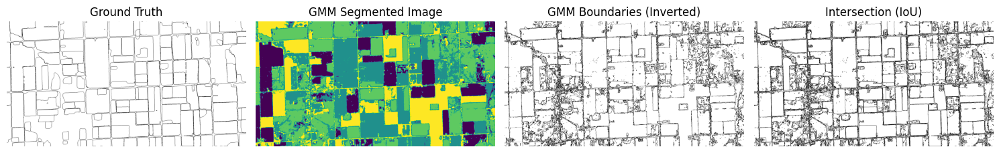

Processing 2(300).jpg...


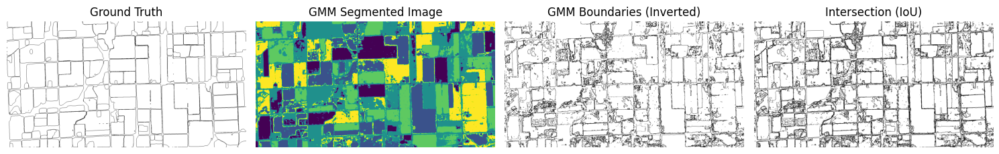

Processing 3(300).jpg...


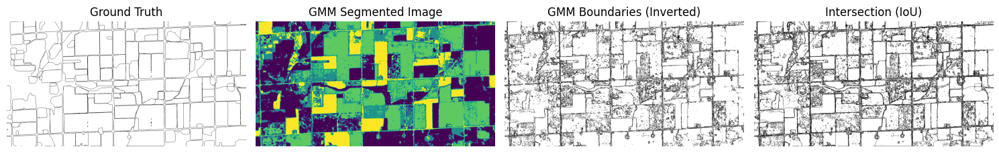

Processing 4(300).jpg...


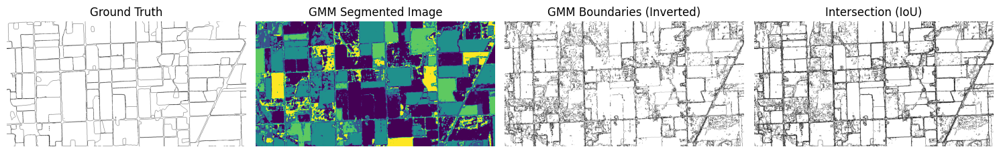

Processing 5(300).jpg...


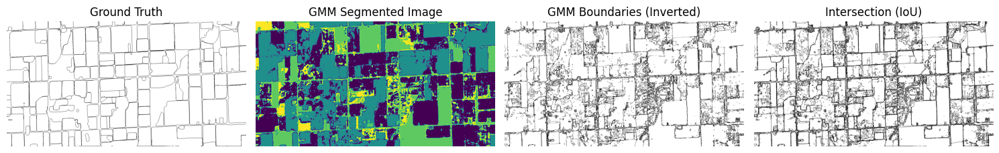

Processing 6(300).jpg...


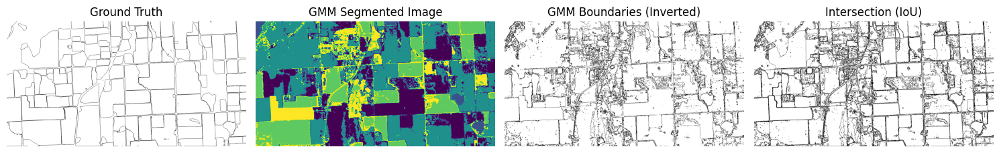

Processing 7(300).jpg...


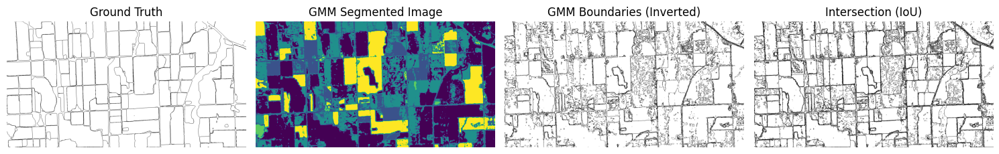

Processing 8(300).jpg...


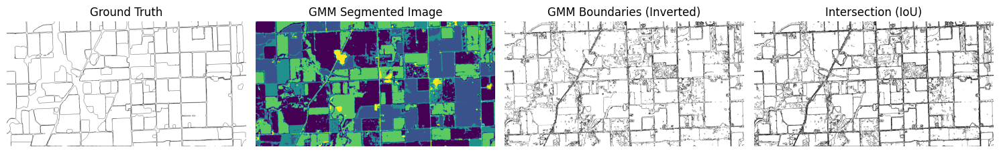

Processing 9(300).jpg...


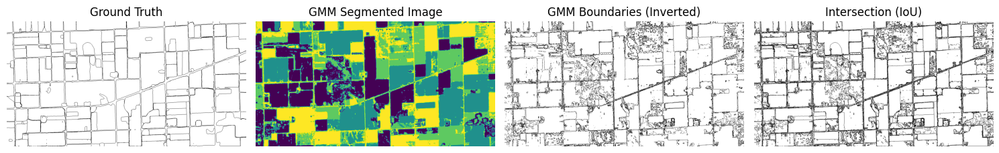

Processing 10(300).jpg...


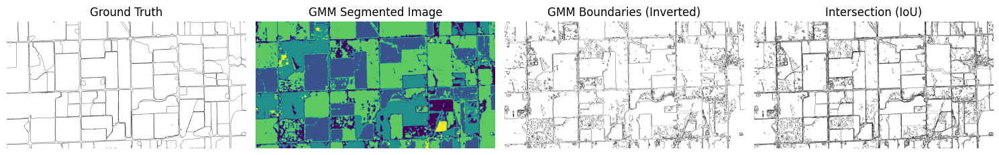


IoU Scores for all images:
1(300).jpg: 0.85
2(300).jpg: 0.85
3(300).jpg: 0.82
4(300).jpg: 0.86
5(300).jpg: 0.85
6(300).jpg: 0.86
7(300).jpg: 0.86
8(300).jpg: 0.87
9(300).jpg: 0.86
10(300).jpg: 0.89


In [ ]:
def process_image_with_gmm(image_path, label_path, gmm_clusters=5, min_area=1500):
    """Process a single image using GMM to calculate IoU and visualize."""
    # Load the raw image
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, _ = image_rgb.shape

    # Load the labeled image
    ground_truth_mask = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
    ground_truth_mask_resized = cv2.resize(ground_truth_mask, (w, h))

    # Apply Gaussian Mixture Model (GMM) for clustering
    pixel_values = image_rgb.reshape(-1, 3)
    gmm = GMM(n_components=gmm_clusters, random_state=0)
    gmm_labels = gmm.fit_predict(pixel_values)
    gmm_segmented_image = gmm_labels.reshape(h, w)

    # Extract boundaries from GMM segmentation
    gmm_boundaries = find_boundaries(gmm_segmented_image, mode='outer').astype(np.uint8)
    gmm_boundaries_inverted = 1 - gmm_boundaries

    # Ensure both masks are binary
    predicted_mask_binary = gmm_boundaries_inverted
    ground_truth_mask_binary = (ground_truth_mask_resized > 0).astype(np.uint8)

    # Calculate IoU
    intersection = np.logical_and(predicted_mask_binary, ground_truth_mask_binary)
    union = np.logical_or(predicted_mask_binary, ground_truth_mask_binary)
    iou_score = np.sum(intersection) / np.sum(union)

    # Visualize the comparison
    plt.figure(figsize=(15, 5))

    # Ground Truth
    plt.subplot(1, 4, 1)
    plt.title("Ground Truth")
    plt.imshow(ground_truth_mask_binary, cmap='gray')
    plt.axis('off')

    # GMM Segmented Image
    plt.subplot(1, 4, 2)
    plt.title("GMM Segmented Image")
    plt.imshow(gmm_segmented_image, cmap='viridis')
    plt.axis('off')

    # GMM Boundaries
    plt.subplot(1, 4, 3)
    plt.title("GMM Boundaries (Inverted)")
    plt.imshow(gmm_boundaries_inverted, cmap='gray')
    plt.axis('off')

    # Intersection
    plt.subplot(1, 4, 4)
    plt.title("Intersection (IoU)")
    plt.imshow(intersection, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    return iou_score

# Paths
image_folder = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/300/raw'
label_folder = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/300/labeled '

# Process all images
iou_scores = []
for filename in os.listdir(image_folder):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(image_folder, filename)
        label_path = os.path.join(label_folder, f"{os.path.splitext(filename)[0]}_labeled.png")

        if os.path.exists(label_path):
            print(f"Processing {filename}...")
            iou_score = process_image_with_gmm(image_path, label_path, gmm_clusters=5)
            iou_scores.append((filename, iou_score))
        else:
            print(f"Warning: No matching labeled image for {filename}")

# Print IoU results
print("\nIoU Scores for all images:")
for filename, iou_score in iou_scores:
    print(f"{filename}: {iou_score:.2f}")



Processing 1(500).jpg...


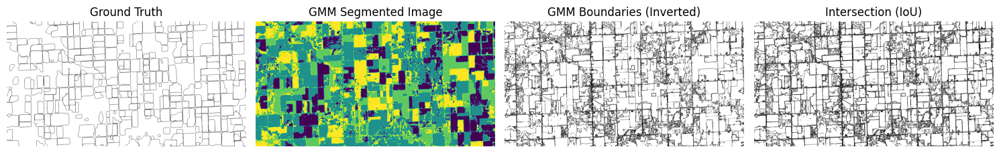

Processing 2(500).jpg...


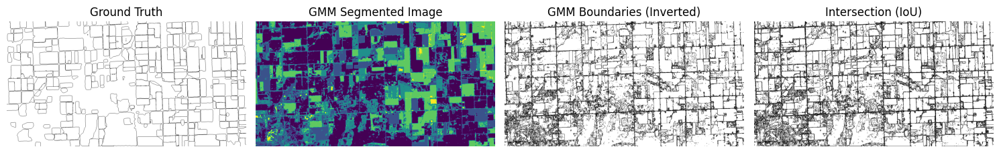

Processing 3(500).jpg...


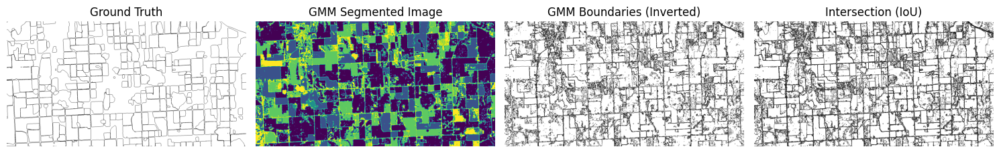

Processing 4(500).jpg...


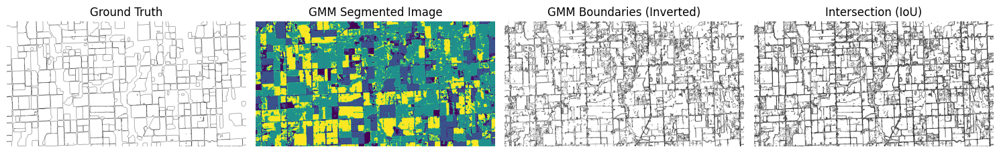

Processing 5(500).jpg...


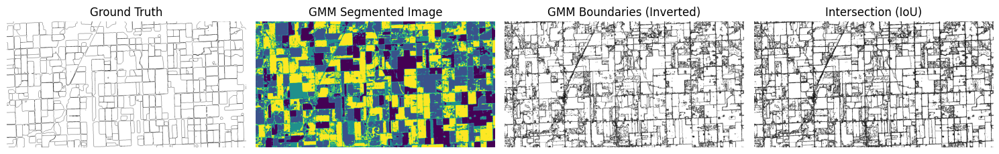

Processing 6(500).jpg...


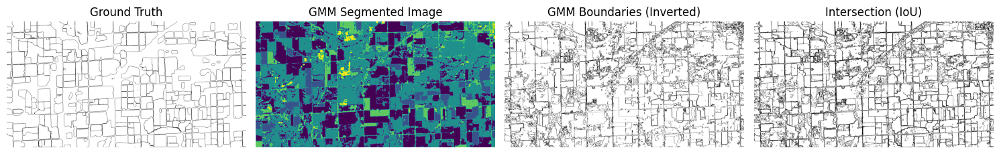

Processing 7(500).jpg...


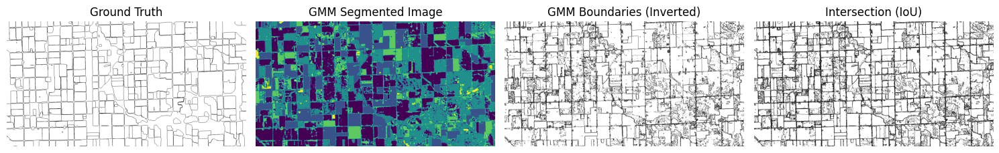

Processing 8(500).jpg...


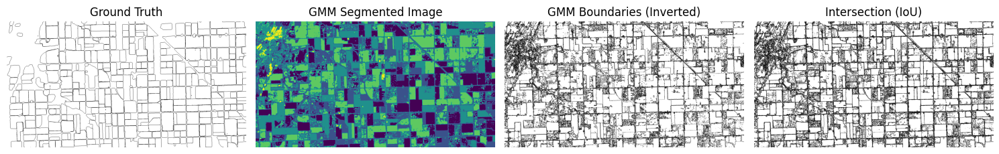

Processing 9(500).jpg...


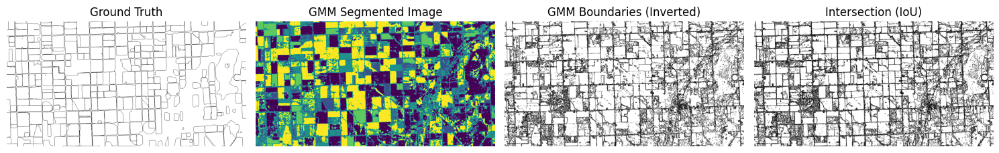

Processing 10(500).jpg...


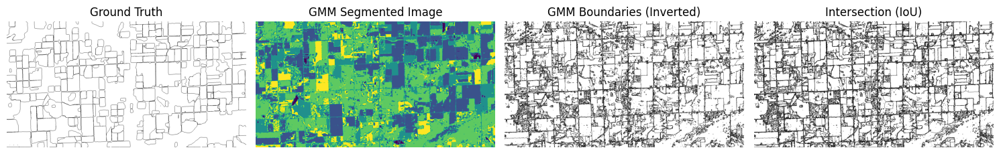


IoU Scores for all images:
1(500).jpg: 0.81
2(500).jpg: 0.79
3(500).jpg: 0.80
4(500).jpg: 0.82
5(500).jpg: 0.80
6(500).jpg: 0.85
7(500).jpg: 0.83
8(500).jpg: 0.76
9(500).jpg: 0.75
10(500).jpg: 0.78


In [ ]:
from skimage.segmentation import find_boundaries

def process_image_with_gmm(image_path, label_path, gmm_clusters=5):
    """Process a single image using GMM to calculate IoU and visualize."""
    # Load the raw image
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, _ = image_rgb.shape

    # Load the labeled image
    ground_truth_mask = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)
    ground_truth_mask_resized = cv2.resize(ground_truth_mask, (w, h))

    # GMM for clustering
    pixel_values = image_rgb.reshape(-1, 3)
    gmm = GMM(n_components=gmm_clusters, random_state=0)
    gmm_labels = gmm.fit_predict(pixel_values)
    gmm_segmented_image = gmm_labels.reshape(h, w)

    # Extract boundaries from GMM segmentation
    gmm_boundaries = find_boundaries(gmm_segmented_image, mode='outer').astype(np.uint8)
    gmm_boundaries_inverted = 1 - gmm_boundaries

    # Ensure both masks are binary
    predicted_mask_binary = gmm_boundaries_inverted
    ground_truth_mask_binary = (ground_truth_mask_resized > 0).astype(np.uint8)

    # Calculate IoU
    intersection = np.logical_and(predicted_mask_binary, ground_truth_mask_binary)
    union = np.logical_or(predicted_mask_binary, ground_truth_mask_binary)
    iou_score = np.sum(intersection) / np.sum(union)

    # Visualize the comparison
    plt.figure(figsize=(15, 5))

    # Ground Truth
    plt.subplot(1, 4, 1)
    plt.title("Ground Truth")
    plt.imshow(ground_truth_mask_binary, cmap='gray')
    plt.axis('off')

    # GMM Segmented Image
    plt.subplot(1, 4, 2)
    plt.title("GMM Segmented Image")
    plt.imshow(gmm_segmented_image, cmap='viridis')
    plt.axis('off')

    # GMM Boundaries
    plt.subplot(1, 4, 3)
    plt.title("GMM Boundaries (Inverted)")
    plt.imshow(gmm_boundaries_inverted, cmap='gray')
    plt.axis('off')

    # Intersection
    plt.subplot(1, 4, 4)
    plt.title("Intersection (IoU)")
    plt.imshow(intersection, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    return iou_score

# Paths
image_folder = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/500/raw'
label_folder = '/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/final_data/500/labeled '

# Process all images
iou_scores = []
for filename in os.listdir(image_folder):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(image_folder, filename)
        label_path = os.path.join(label_folder, f"{os.path.splitext(filename)[0]}_labeled.png")

        if os.path.exists(label_path):
            print(f"Processing {filename}...")
            iou_score = process_image_with_gmm(image_path, label_path, gmm_clusters=5)
            iou_scores.append((filename, iou_score))
        else:
            print(f"Warning: No matching labeled image for {filename}")

# Print IoU results
print("\nIoU Scores for all images:")
for filename, iou_score in iou_scores:
    print(f"{filename}: {iou_score:.2f}")



In [14]:
%pip install rasterio

# Entire county approach


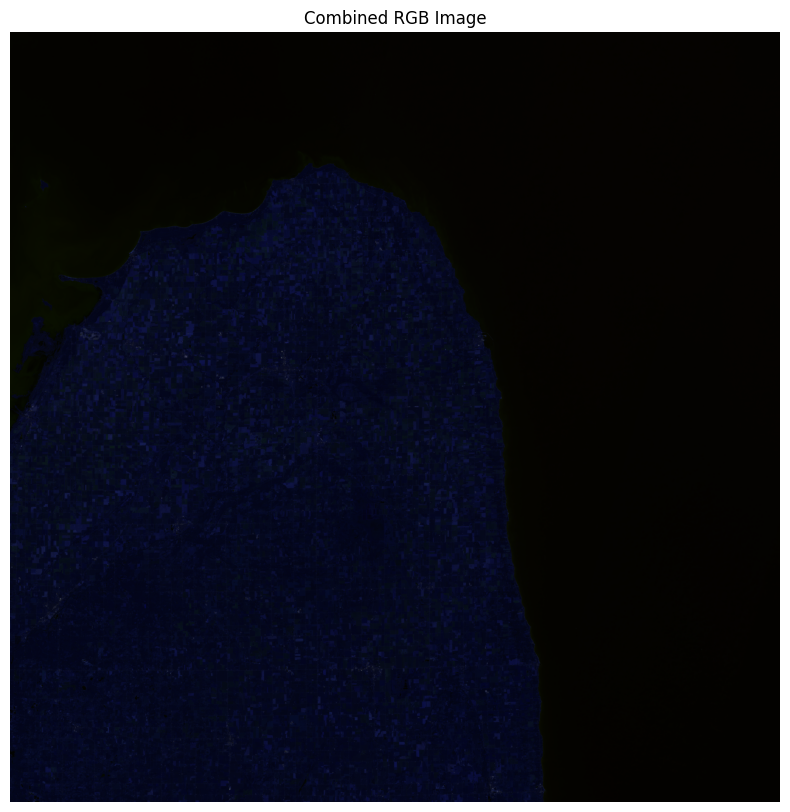

In [58]:
import rasterio

# Path to the GeoTIFF file
tif_file_path = "/content/county_bands_2_3_11.tif"

def combine_bands_to_rgb(tif_file_path):
    # Open the GeoTIFF file
    with rasterio.open(tif_file_path) as src:
        # Read the bands (assuming the file contains only 3 bands)
        band_r = src.read(1)  # Band 1 corresponds to original Band 2 (Red)
        band_g = src.read(2)  # Band 2 corresponds to original Band 3 (Green)
        band_b = src.read(3)  # Band 3 corresponds to original Band 11 (Blue)

        # Normalize the bands to 8-bit (0-255)
        def normalize_band(band):
            band = band.astype(np.float32)
            return ((band - np.min(band)) / (np.max(band) - np.min(band)) * 255).astype(np.uint8)

        band_r = normalize_band(band_r)
        band_g = normalize_band(band_g)
        band_b = normalize_band(band_b)

        # Stack the bands to form an RGB image
        rgb_image = np.dstack((band_r, band_g, band_b))

        # Plot the combined RGB image
        plt.figure(figsize=(10, 10))
        plt.title("Combined RGB Image")
        plt.imshow(rgb_image)
        plt.axis('off')
        plt.show()

        return rgb_image

# Combine the bands and visualize
rgb_image = combine_bands_to_rgb(tif_file_path)



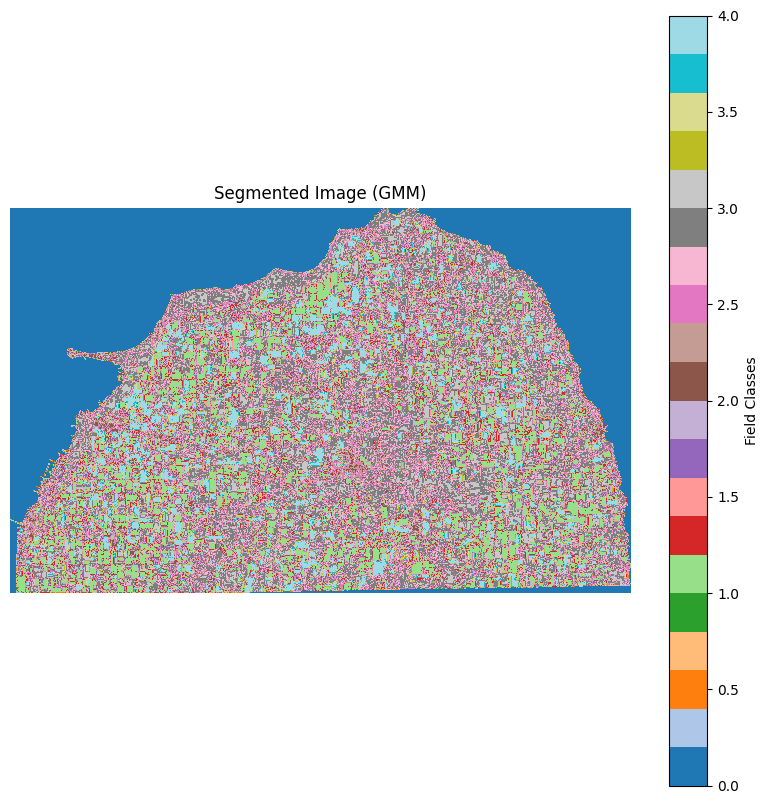

Total number of fields detected: 1805


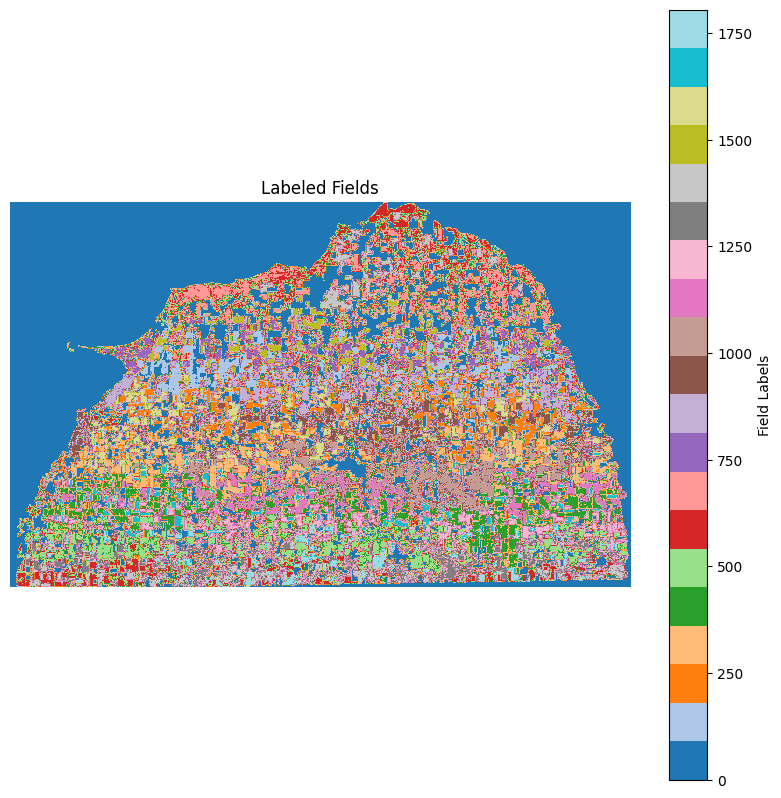

Total fields detected: 1805


In [106]:
def identify_and_count_fields(B02, B03, B11, gmm_clusters=5, min_field_size=500):
    """Identify and count fields in the image."""
    # Combine bands into a single feature vector
    h, w = B02.shape
    pixel_values = np.stack([B02.ravel(), B03.ravel(), B11.ravel()], axis=1)

    # Apply GMM to segment the image
    gmm = GMM(n_components=gmm_clusters, random_state=0)
    gmm_labels = gmm.fit_predict(pixel_values)
    segmented_image = gmm_labels.reshape(h, w)

    # Visualize segmented image
    plt.figure(figsize=(10, 10))
    plt.imshow(segmented_image, cmap='tab20')
    plt.title("Segmented Image (GMM)")
    plt.axis('off')
    plt.colorbar(label="Field Classes")
    plt.show()

    # Count fields for each class
    total_fields = 0
    labeled_image = np.zeros_like(segmented_image, dtype=np.int32)
    for field_class in range(gmm_clusters):
        # Create a binary mask for the current field class
        class_mask = segmented_image == field_class

        # Remove small objects (noise)
        class_mask_cleaned = remove_small_objects(class_mask, min_size=min_field_size)

        # Label connected components
        labeled_class = label(class_mask_cleaned)
        labeled_image[class_mask_cleaned] = labeled_class[class_mask_cleaned] + total_fields

        # Update total fields count
        total_fields += np.max(labeled_class)

    print(f"Total number of fields detected: {total_fields}")

    # Visualize labeled fields
    plt.figure(figsize=(10, 10))
    plt.imshow(labeled_image, cmap='tab20')
    plt.title("Labeled Fields")
    plt.axis('off')
    plt.colorbar(label="Field Labels")
    plt.show()

    return total_fields

# Call the function
field_count = identify_and_count_fields(B02, B03, B11, gmm_clusters=5, min_field_size=500)
print(f"Total fields detected: {field_count}")

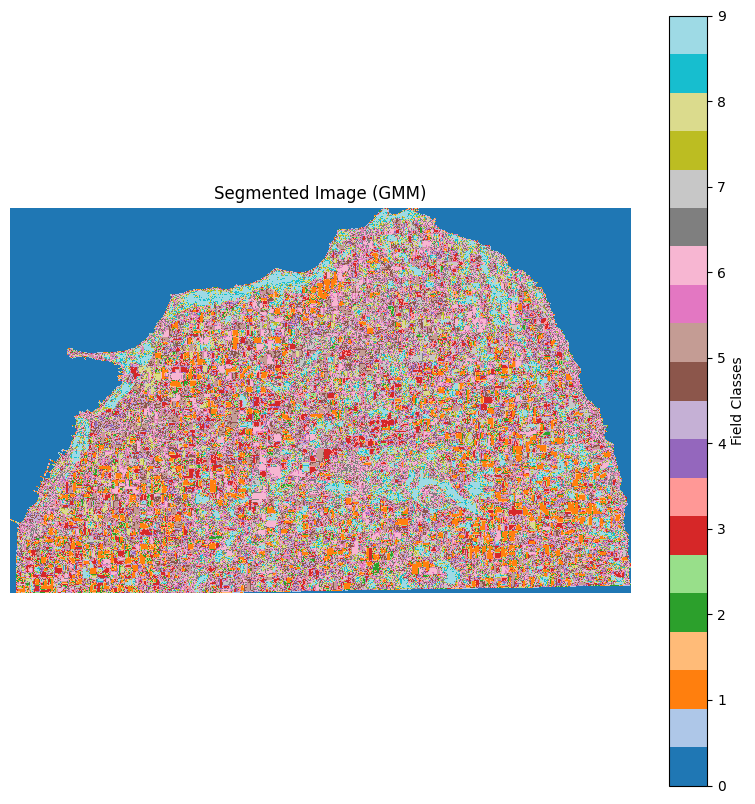

Total number of fields detected: 8187


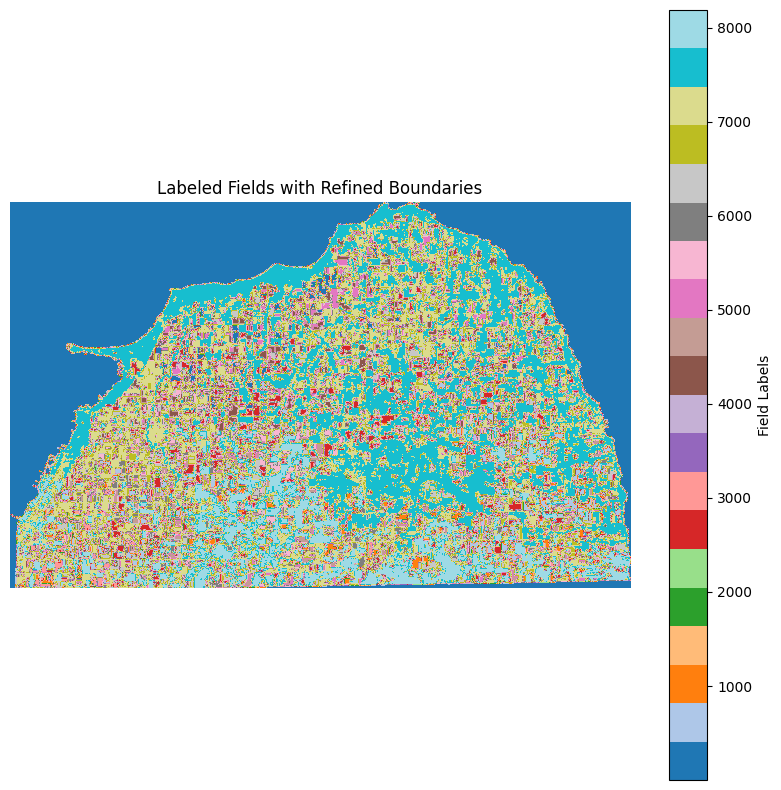

Total fields detected: 8187


In [33]:
from sklearn.mixture import GaussianMixture as GMM
from skimage.measure import label
from skimage.morphology import remove_small_objects, binary_dilation, disk
import numpy as np
import matplotlib.pyplot as plt

def refine_and_count_fields(B02, B03, B11, gmm_clusters=10, min_field_size=100, boundary_dilation=3):
    """Refine and count fields in the image with improved boundary handling."""
    # Combine bands into a single feature vector
    h, w = B02.shape
    pixel_values = np.stack([B02.ravel(), B03.ravel(), B11.ravel()], axis=1)

    # Apply GMM to segment the image
    gmm = GMM(n_components=gmm_clusters, random_state=0)
    gmm_labels = gmm.fit_predict(pixel_values)
    segmented_image = gmm_labels.reshape(h, w)

    # Visualize segmented image
    plt.figure(figsize=(10, 10))
    plt.imshow(segmented_image, cmap='tab20')
    plt.title("Segmented Image (GMM)")
    plt.axis('off')
    plt.colorbar(label="Field Classes")
    plt.show()

    # Count fields for each class
    total_fields = 0
    labeled_image = np.zeros_like(segmented_image, dtype=np.int32)
    for field_class in range(gmm_clusters):
        # Create a binary mask for the current field class
        class_mask = segmented_image == field_class

        # Apply boundary dilation to close small gaps
        class_mask_dilated = binary_dilation(class_mask, disk(boundary_dilation))

        # Remove small objects (noise)
        class_mask_cleaned = remove_small_objects(class_mask_dilated, min_size=min_field_size)

        # Label connected components
        labeled_class = label(class_mask_cleaned)
        labeled_image[class_mask_cleaned] = labeled_class[class_mask_cleaned] + total_fields

        # Update total fields count
        total_fields += np.max(labeled_class)

    print(f"Total number of fields detected: {total_fields}")

    # Visualize labeled fields
    plt.figure(figsize=(10, 10))
    plt.imshow(labeled_image, cmap='tab20')
    plt.title("Labeled Fields with Refined Boundaries")
    plt.axis('off')
    plt.colorbar(label="Field Labels")
    plt.show()

    return total_fields

# Call the function with improved boundary handling
field_count = refine_and_count_fields(B02, B03, B11, gmm_clusters=10, min_field_size=100, boundary_dilation=3)
print(f"Total fields detected: {field_count}")

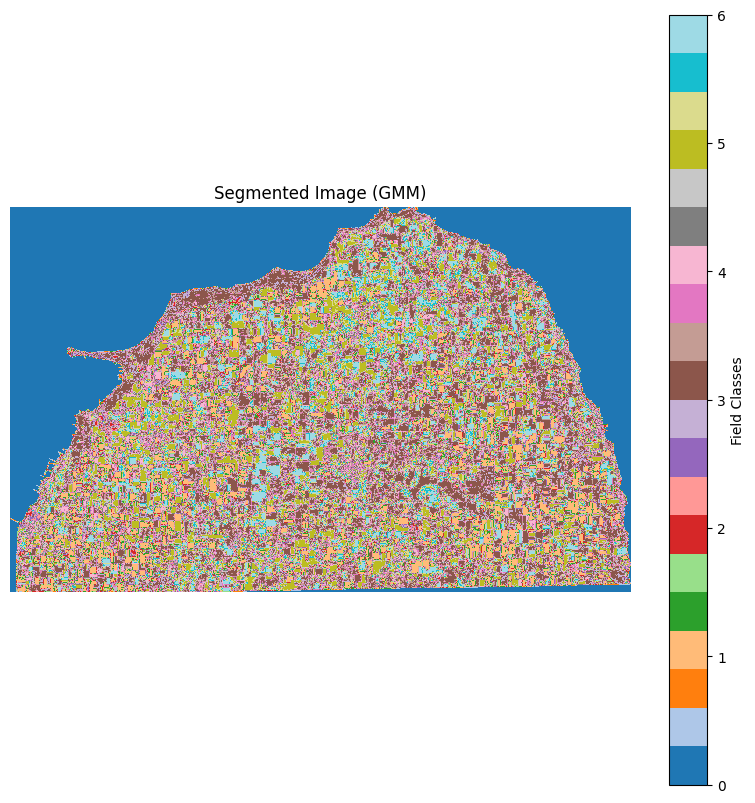

Total number of fields detected: 17684


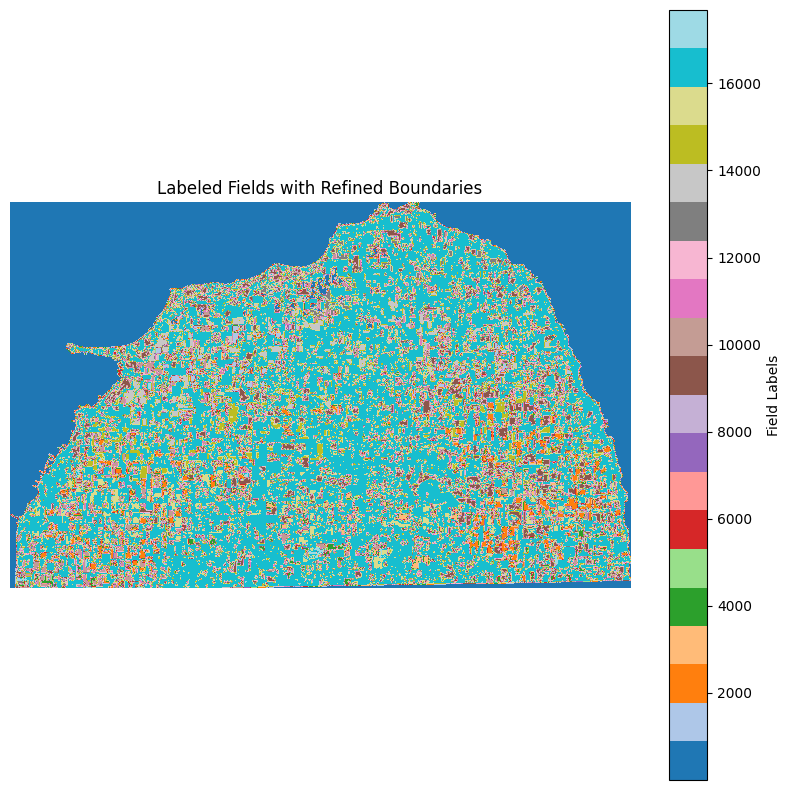

Total fields detected: 17684


In [38]:
from sklearn.mixture import GaussianMixture as GMM
from skimage.measure import label
from skimage.morphology import remove_small_objects, binary_dilation, disk
import numpy as np
import matplotlib.pyplot as plt

def refine_and_count_fields(B02, B03, B11, gmm_clusters=7, min_field_size=22, boundary_dilation=3):
    """Refine and count fields in the image with improved boundary handling."""
    # Combine bands into a single feature vector
    h, w = B02.shape
    pixel_values = np.stack([B02.ravel(), B03.ravel(), B11.ravel()], axis=1)

    # Apply GMM to segment the image
    gmm = GMM(n_components=gmm_clusters, random_state=0)
    gmm_labels = gmm.fit_predict(pixel_values)
    segmented_image = gmm_labels.reshape(h, w)

    # Visualize segmented image
    plt.figure(figsize=(10, 10))
    plt.imshow(segmented_image, cmap='tab20')
    plt.title("Segmented Image (GMM)")
    plt.axis('off')
    plt.colorbar(label="Field Classes")
    plt.show()

    # Count fields for each class
    total_fields = 0
    labeled_image = np.zeros_like(segmented_image, dtype=np.int32)
    for field_class in range(gmm_clusters):
        # Create a binary mask for the current field class
        class_mask = segmented_image == field_class

        # Apply boundary dilation to close small gaps
        class_mask_dilated = binary_dilation(class_mask, disk(boundary_dilation))

        # Remove small objects (noise)
        class_mask_cleaned = remove_small_objects(class_mask_dilated, min_size=min_field_size)

        # Label connected components
        labeled_class = label(class_mask_cleaned)
        labeled_image[class_mask_cleaned] = labeled_class[class_mask_cleaned] + total_fields

        # Update total fields count
        total_fields += np.max(labeled_class)

    print(f"Total number of fields detected: {total_fields}")

    # Visualize labeled fields
    plt.figure(figsize=(10, 10))
    plt.imshow(labeled_image, cmap='tab20')
    plt.title("Labeled Fields with Refined Boundaries")
    plt.axis('off')
    plt.colorbar(label="Field Labels")
    plt.show()

    return total_fields

# Call the function with improved boundary handling
field_count = refine_and_count_fields(B02, B03, B11, gmm_clusters=7, min_field_size=22, boundary_dilation=3)
print(f"Total fields detected: {field_count}")


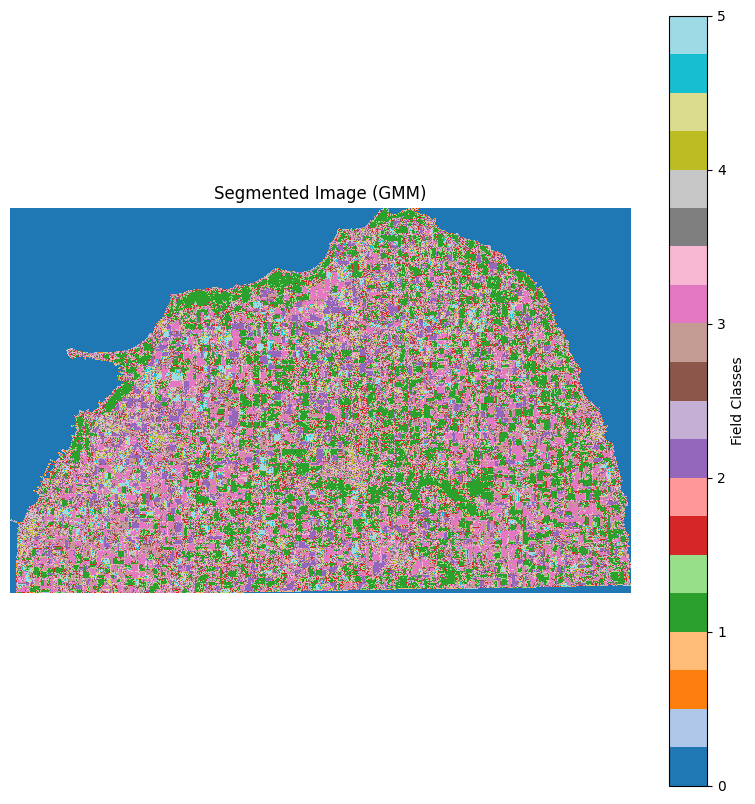

Total number of fields detected: 20136


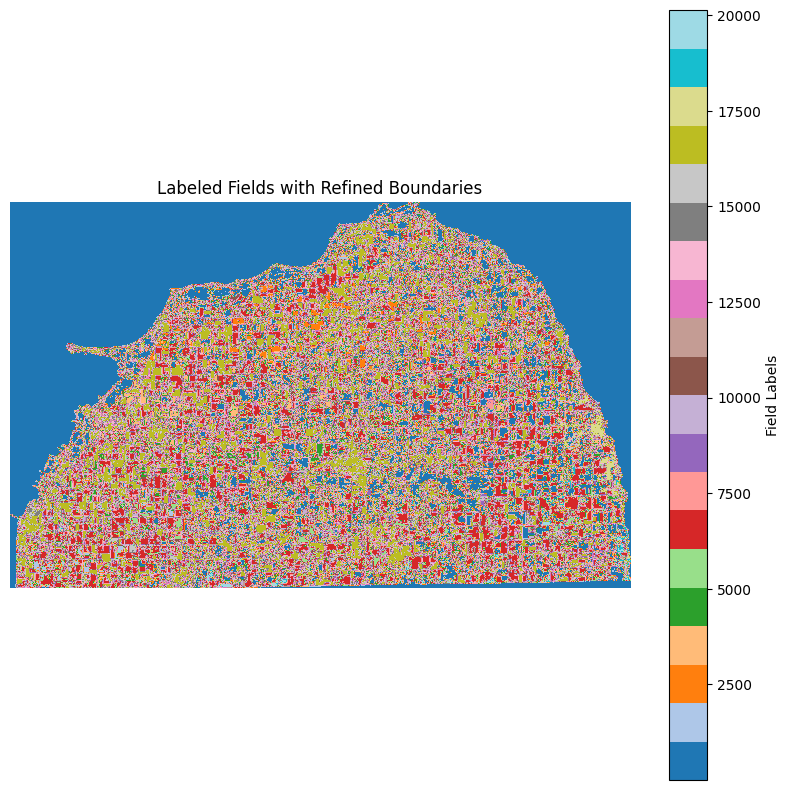

Total fields detected: 20136


In [72]:
from sklearn.mixture import GaussianMixture as GMM
from skimage.measure import label
from skimage.morphology import remove_small_objects, binary_dilation, disk
import numpy as np
import matplotlib.pyplot as plt
import rasterio
from rasterio.mask import mask
import geopandas as gpd

def combine_bands_to_rgb_and_crop(tif_file_path, county_shapefile):
    """Combine bands into an RGB image and crop to county boundaries."""
    # Load county boundary
    county_boundary = gpd.read_file(county_shapefile).to_crs("EPSG:32617")
    masked_geometries = [geom for geom in county_boundary.geometry]

    with rasterio.open(tif_file_path) as src:
        crs = src.crs
        cropped_image, transform = mask(src, masked_geometries, crop=True)

        # Read bands (assuming band 1=B02, band 2=B03, band 3=B11)
        B02 = cropped_image[0].astype(np.float32)
        B03 = cropped_image[1].astype(np.float32)
        B11 = cropped_image[2].astype(np.float32)

    return B02, B03, B11

def normalize_to_uint8(band):
    band_min = np.nanmin(band)
    band_max = np.nanmax(band)
    if band_min == band_max:
        return (band * 0).astype(np.uint8)
    normalized = (band - band_min) / (band_max - band_min) * 255
    return normalized.astype(np.uint8)

def refine_and_count_fields(B02, B03, B11, gmm_clusters=5, min_field_size=9, boundary_dilation=2):
    """Refine and count fields in the image with improved boundary handling."""
    # Combine bands into a single feature vector
    h, w = B02.shape
    pixel_values = np.stack([B02.ravel(), B03.ravel(), B11.ravel()], axis=1)

    # Apply GMM to segment the image
    gmm = GMM(n_components=gmm_clusters, random_state=0)
    gmm_labels = gmm.fit_predict(pixel_values)
    segmented_image = gmm_labels.reshape(h, w)

    # Visualize segmented image
    plt.figure(figsize=(10, 10))
    plt.imshow(segmented_image, cmap='tab20')
    plt.title("Segmented Image (GMM)")
    plt.axis('off')
    plt.colorbar(label="Field Classes")
    plt.show()

    # Count fields for each class
    total_fields = 0
    labeled_image = np.zeros_like(segmented_image, dtype=np.int32)
    for field_class in range(gmm_clusters):
        # Create a binary mask for the current field class
        class_mask = segmented_image == field_class

        # Apply boundary dilation to close small gaps
        class_mask_dilated = binary_dilation(class_mask, disk(boundary_dilation))

        # Remove small objects (noise)
        class_mask_cleaned = remove_small_objects(class_mask_dilated, min_size=min_field_size)

        # Label connected components
        labeled_class = label(class_mask_cleaned)
        labeled_image[class_mask_cleaned] = labeled_class[class_mask_cleaned] + total_fields

        # Update total fields count
        total_fields += np.max(labeled_class)

    print(f"Total number of fields detected: {total_fields}")

    # Visualize labeled fields
    plt.figure(figsize=(10, 10))
    plt.imshow(labeled_image, cmap='tab20')
    plt.title("Labeled Fields with Refined Boundaries")
    plt.axis('off')
    plt.colorbar(label="Field Labels")
    plt.show()

    return total_fields

# Paths
tif_file_path = "/content/county_bands_2_3_11.tif"
county_shapefile = "/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/shp_gmu/26063.shp"

# Combine and crop bands
B02, B03, B11 = combine_bands_to_rgb_and_crop(tif_file_path, county_shapefile)

# Normalize bands (optional, if required for visualization or processing)
B02_normalized = normalize_to_uint8(B02)
B03_normalized = normalize_to_uint8(B03)
B11_normalized = normalize_to_uint8(B11)

# Refine and count fields
field_count = refine_and_count_fields(B02_normalized, B03_normalized, B11_normalized, gmm_clusters=6, min_field_size=9, boundary_dilation=2)
print(f"Total fields detected: {field_count}")


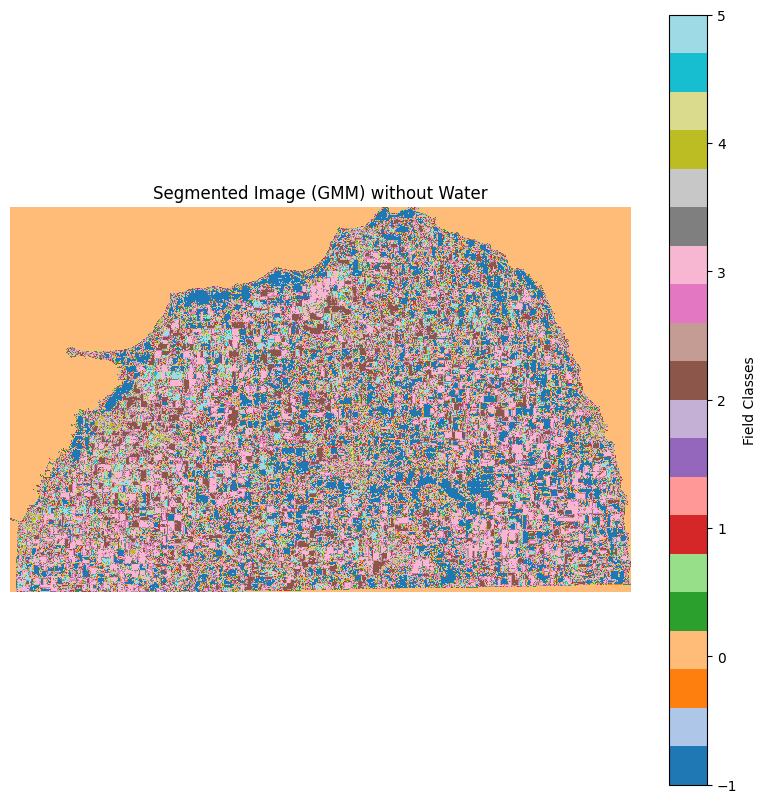

Total number of fields detected: 18461

Field Class Statistics:
Class 0: Total Acreage = 226714600.00 m², Field Count = 1
Class 2: Total Acreage = 117111100.00 m², Field Count = 4819
Class 3: Total Acreage = 317114800.00 m², Field Count = 3353
Class 4: Total Acreage = 62082400.00 m², Field Count = 6822
Class 5: Total Acreage = 210644100.00 m², Field Count = 3466

Total Acreage: 933667000.00 m²


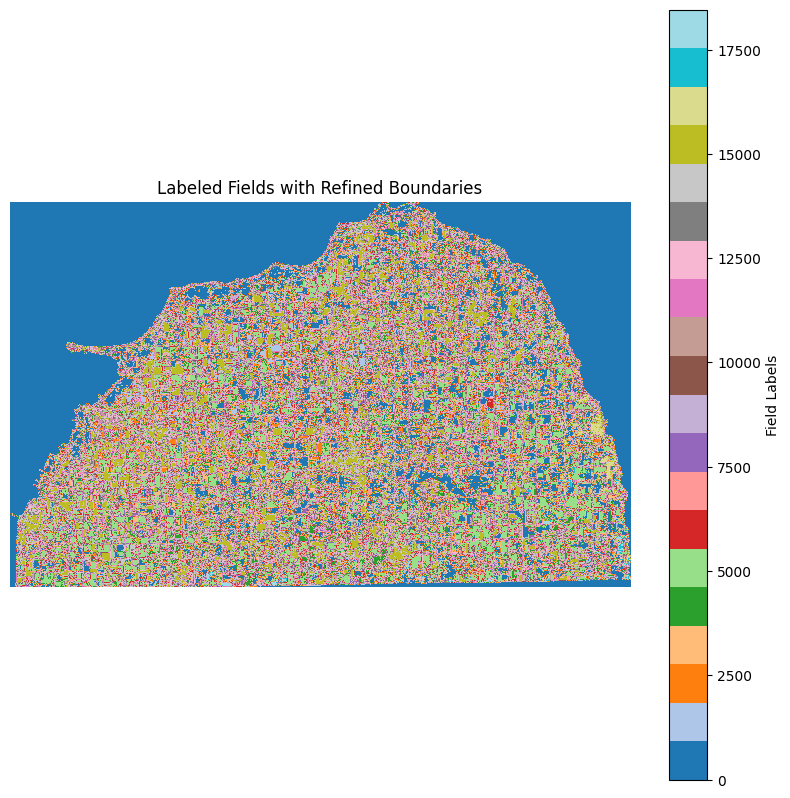

Total fields detected: 18461
Total acreage: 933667000.00 m²


In [75]:
from sklearn.mixture import GaussianMixture as GMM
from skimage.measure import label
from skimage.morphology import remove_small_objects, binary_dilation, disk
import numpy as np
import matplotlib.pyplot as plt
import rasterio
from rasterio.mask import mask
import geopandas as gpd

def combine_bands_to_rgb_and_crop(tif_file_path, county_shapefile):
    """Combine bands into an RGB image and crop to county boundaries."""
    # Load county boundary
    county_boundary = gpd.read_file(county_shapefile).to_crs("EPSG:32617")
    masked_geometries = [geom for geom in county_boundary.geometry]

    with rasterio.open(tif_file_path) as src:
        crs = src.crs
        transform = src.transform
        cropped_image, transform = mask(src, masked_geometries, crop=True)

        # Read bands (assuming band 1=B02, band 2=B03, band 3=B11)
        B02 = cropped_image[0].astype(np.float32)
        B03 = cropped_image[1].astype(np.float32)
        B11 = cropped_image[2].astype(np.float32)

    return B02, B03, B11, transform

def normalize_to_uint8(band):
    band_min = np.nanmin(band)
    band_max = np.nanmax(band)
    if band_min == band_max:
        return (band * 0).astype(np.uint8)
    normalized = (band - band_min) / (band_max - band_min) * 255
    return normalized.astype(np.uint8)

def refine_and_count_fields(B02, B03, B11, transform, gmm_clusters=5, min_field_size=9, boundary_dilation=2):
    """Refine and count fields in the image with improved boundary handling."""
    # Combine bands into a single feature vector
    h, w = B02.shape
    pixel_values = np.stack([B02.ravel(), B03.ravel(), B11.ravel()], axis=1)

    # Apply GMM to segment the image
    gmm = GMM(n_components=gmm_clusters, random_state=0)
    gmm_labels = gmm.fit_predict(pixel_values)
    segmented_image = gmm_labels.reshape(h, w)

    # Identify and mask the water cluster (largest cluster surrounding the land)
    unique_labels, label_counts = np.unique(segmented_image, return_counts=True)
    water_cluster = unique_labels[np.argmax(label_counts)]
    water_mask = segmented_image == water_cluster
    segmented_image[water_mask] = -1  # Mask water cluster

    # Visualize segmented image
    plt.figure(figsize=(10, 10))
    plt.imshow(segmented_image, cmap='tab20')
    plt.title("Segmented Image (GMM) without Water")
    plt.axis('off')
    plt.colorbar(label="Field Classes")
    plt.show()

    # Calculate pixel area in square meters
    pixel_area_B02_B03 = 10 * 10  # 10m resolution for B02 and B03
    pixel_area_B11 = 20 * 20      # 20m resolution for B11
    pixel_area = pixel_area_B02_B03  # Using the highest resolution band for acreage

    # Count fields for each class and calculate acreage
    total_fields = 0
    field_areas = []
    labeled_image = np.zeros_like(segmented_image, dtype=np.int32)
    for field_class in range(gmm_clusters):
        if field_class == water_cluster:
            continue  # Skip water cluster

        # Create a binary mask for the current field class
        class_mask = segmented_image == field_class

        # Apply boundary dilation to close small gaps
        class_mask_dilated = binary_dilation(class_mask, disk(boundary_dilation))

        # Remove small objects (noise)
        class_mask_cleaned = remove_small_objects(class_mask_dilated, min_size=min_field_size)

        # Label connected components
        labeled_class = label(class_mask_cleaned)
        labeled_image[class_mask_cleaned] = labeled_class[class_mask_cleaned] + total_fields

        # Calculate acreage for each labeled field
        unique_labels, label_counts = np.unique(labeled_class, return_counts=True)
        class_areas = label_counts[1:] * pixel_area  # Skip background label (0)

        field_areas.append((field_class, np.sum(class_areas), len(unique_labels) - 1))  # Total area and count per class

        # Update total fields count
        total_fields += len(unique_labels) - 1

    print(f"Total number of fields detected: {total_fields}")

    # Print acreage details
    print("\nField Class Statistics:")
    total_acreage = 0
    for field_class, class_area, field_count in field_areas:
        total_acreage += class_area
        print(f"Class {field_class}: Total Acreage = {class_area:.2f} m², Field Count = {field_count}")

    print(f"\nTotal Acreage: {total_acreage:.2f} m²")

    # Visualize labeled fields
    plt.figure(figsize=(10, 10))
    plt.imshow(labeled_image, cmap='tab20')
    plt.title("Labeled Fields with Refined Boundaries")
    plt.axis('off')
    plt.colorbar(label="Field Labels")
    plt.show()

    return total_fields, total_acreage

# Paths
tif_file_path = "/content/county_bands_2_3_11.tif"
county_shapefile = "/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/shp_gmu/26063.shp"

# Combine and crop bands
B02, B03, B11, transform = combine_bands_to_rgb_and_crop(tif_file_path, county_shapefile)

# Normalize bands (optional, if required for visualization or processing)
B02_normalized = normalize_to_uint8(B02)
B03_normalized = normalize_to_uint8(B03)
B11_normalized = normalize_to_uint8(B11)

# Refine and count fields
field_count, total_acreage = refine_and_count_fields(B02_normalized, B03_normalized, B11_normalized, transform, gmm_clusters=6, min_field_size=9, boundary_dilation=2)
print(f"Total fields detected: {field_count}")
print(f"Total acreage: {total_acreage:.2f} m²")


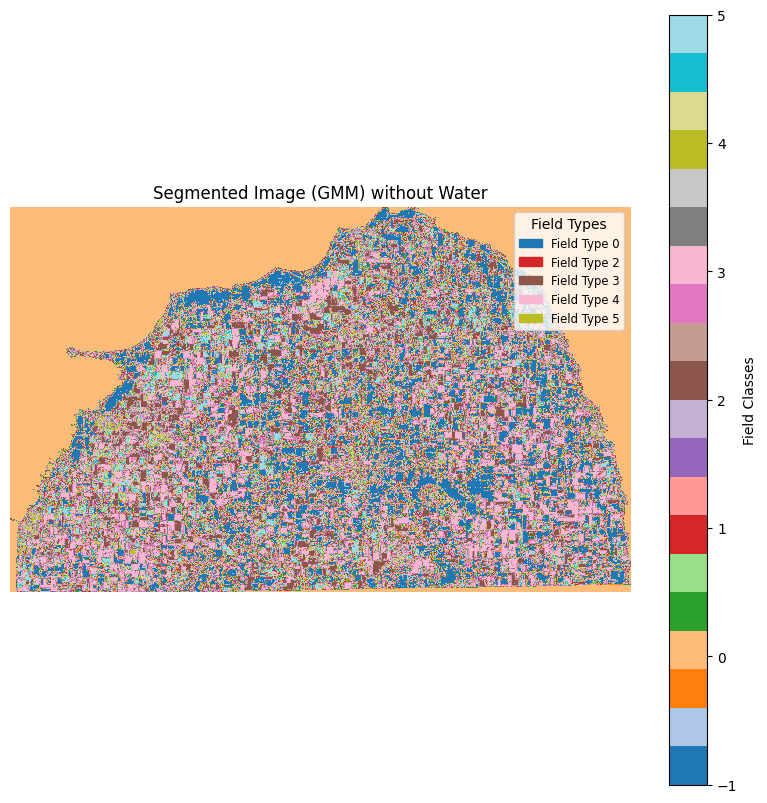

Total number of fields detected: 18461

Field Class Statistics:
Class 0: Total Acreage = 453429200.00 m², Field Count = 1
Class 2: Total Acreage = 234222200.00 m², Field Count = 4819
Class 3: Total Acreage = 634229600.00 m², Field Count = 3353
Class 4: Total Acreage = 124164800.00 m², Field Count = 6822
Class 5: Total Acreage = 421288200.00 m², Field Count = 3466

Total Acreage: 1867334000.00 m²


ValueError: not enough values to unpack (expected 4, got 2)

In [90]:
import matplotlib.patches as mpatches

def refine_and_count_fields(B02, B03, B11, transform, gmm_clusters=5, min_field_size=9, boundary_dilation=2):
    """Refine and count fields in the image with improved boundary handling."""
    h, w = B02.shape
    pixel_values = np.stack([B02.ravel(), B03.ravel(), B11.ravel()], axis=1)

    # Apply GMM to segment the image
    gmm = GMM(n_components=gmm_clusters, random_state=0)
    gmm_labels = gmm.fit_predict(pixel_values)
    segmented_image = gmm_labels.reshape(h, w)

    # Identify and mask the water cluster (largest cluster surrounding the land)
    unique_labels, label_counts = np.unique(segmented_image, return_counts=True)
    water_cluster = unique_labels[np.argmax(label_counts)]
    water_mask = segmented_image == water_cluster
    segmented_image[water_mask] = -1  # Mask water cluster

    # Visualize segmented image with legend
    plt.figure(figsize=(10, 10))
    plt.imshow(segmented_image, cmap='tab20')
    plt.title("Segmented Image (GMM) without Water")
    plt.axis('off')
    plt.colorbar(label="Field Classes")

    # Add a legend
    legend_handles = [
        mpatches.Patch(color=plt.cm.tab20(i / gmm_clusters), label=f"Field Type {i}")
        for i in range(gmm_clusters) if i != water_cluster
    ]
    plt.legend(handles=legend_handles, loc="upper right", title="Field Types", fontsize='small')
    plt.show()

    # Calculate pixel area in square meters
    pixel_area = 10 * 20  # Adjusted resolution

    # Count fields for each class and calculate acreage
    total_fields = 0
    field_areas = []
    labeled_image = np.zeros_like(segmented_image, dtype=np.int32)
    for field_class in range(gmm_clusters):
        if field_class == water_cluster:
            continue  # Skip water cluster

        # Create a binary mask for the current field class
        class_mask = segmented_image == field_class

        # Apply boundary dilation to close small gaps
        class_mask_dilated = binary_dilation(class_mask, disk(boundary_dilation))

        # Remove small objects (noise)
        class_mask_cleaned = remove_small_objects(class_mask_dilated, min_size=min_field_size)

        # Label connected components
        labeled_class = label(class_mask_cleaned)
        labeled_image[class_mask_cleaned] = labeled_class[class_mask_cleaned] + total_fields

        # Calculate acreage for each labeled field
        unique_labels, label_counts = np.unique(labeled_class, return_counts=True)
        class_areas = label_counts[1:] * pixel_area  # Skip background label (0)

        field_areas.append((field_class, np.sum(class_areas), len(unique_labels) - 1))  # Total area and count per class

        # Update total fields count
        total_fields += len(unique_labels) - 1

    print(f"Total number of fields detected: {total_fields}")

    # Print acreage details
    print("\nField Class Statistics:")
    total_acreage = 0
    for field_class, class_area, field_count in field_areas:
        total_acreage += class_area
        print(f"Class {field_class}: Total Acreage = {class_area:.2f} m², Field Count = {field_count}")

    print(f"\nTotal Acreage: {total_acreage:.2f} m²")

    return total_fields, total_acreage


# Paths
tif_file_path = "/content/county_bands_2_3_11.tif"
county_shapefile = "/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/shp_gmu/26063.shp"

# Combine and crop bands
B02, B03, B11, transform = combine_bands_to_rgb_and_crop(tif_file_path, county_shapefile)

# Normalize bands (optional, if required for visualization or processing)
B02_normalized = normalize_to_uint8(B02)
B03_normalized = normalize_to_uint8(B03)
B11_normalized = normalize_to_uint8(B11)

# Refine and count fields
field_count, total_acreage, total_acreage_acres, avg_acreage_per_field = refine_and_count_fields(
    B02_normalized, B03_normalized, B11_normalized, transform, gmm_clusters=6, min_field_size=9, boundary_dilation=2)

print(f"Total fields detected: {field_count}")
print(f"Total acreage: {total_acreage:.2f} m² ({total_acreage_acres:.2f} acres)")
print(f"Average acreage per field: {avg_acreage_per_field:.2f} acres")



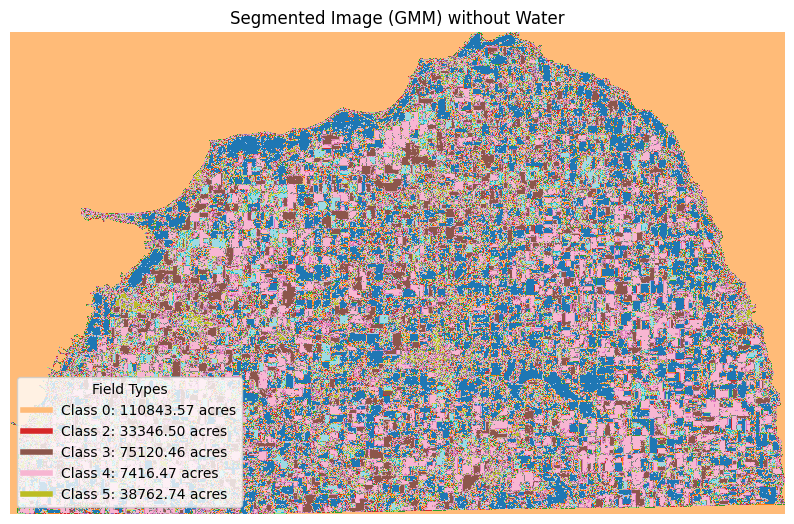

Total number of fields detected: 18461
Total Acreage: 1867334000.00 m² (461427.87 acres)
Average Acreage per Field: 24.99 acres
Total fields detected: 18461
Total acreage: 1867334000.00 m² (461427.87 acres)
Average acreage per field: 24.99 acres


In [96]:
def combine_bands_to_rgb_and_crop(tif_file_path, county_shapefile):
    """Combine bands into an RGB image and crop to county boundaries."""
    # Load county boundary
    county_boundary = gpd.read_file(county_shapefile).to_crs("EPSG:32617")
    masked_geometries = [geom for geom in county_boundary.geometry]

    with rasterio.open(tif_file_path) as src:
        crs = src.crs
        transform = src.transform
        cropped_image, transform = mask(src, masked_geometries, crop=True)

        # Read bands (assuming band 1=B02, band 2=B03, band 3=B11)
        B02 = cropped_image[0].astype(np.float32)
        B03 = cropped_image[1].astype(np.float32)
        B11 = cropped_image[2].astype(np.float32)

    return B02, B03, B11, transform

def normalize_to_uint8(band):
    band_min = np.nanmin(band)
    band_max = np.nanmax(band)
    if band_min == band_max:
        return (band * 0).astype(np.uint8)
    normalized = (band - band_min) / (band_max - band_min) * 255
    return normalized.astype(np.uint8)

def refine_and_count_fields(B02, B03, B11, transform, gmm_clusters=5, min_field_size=9, boundary_dilation=2):
    """Refine and count fields in the image with improved boundary handling."""
    # Combine bands into a single feature vector
    h, w = B02.shape
    pixel_values = np.stack([B02.ravel(), B03.ravel(), B11.ravel()], axis=1)

    # Apply GMM to segment the image
    gmm = GMM(n_components=gmm_clusters, random_state=0)
    gmm_labels = gmm.fit_predict(pixel_values)
    segmented_image = gmm_labels.reshape(h, w)

    # Identify and mask the water cluster (largest cluster surrounding the land)
    unique_labels, label_counts = np.unique(segmented_image, return_counts=True)
    water_cluster = unique_labels[np.argmax(label_counts)]
    water_mask = segmented_image == water_cluster
    segmented_image[water_mask] = -1  # Mask water cluster

    # Visualize segmented image with minimalistic legend
    fig, ax = plt.subplots(figsize=(10, 10))
    im = ax.imshow(segmented_image, cmap='tab20')
    ax.set_title("Segmented Image (GMM) without Water")
    ax.axis('off')

    # Add acreage for each crop type
    acreage_per_class = {}
    for field_class in range(gmm_clusters):
        if field_class == water_cluster:
            continue
        acreage_per_class[field_class] = label_counts[field_class] * (10 * 20) / 4046.86  # Convert to acres

    legend_labels = [f"Class {field_class}: {acreage_per_class[field_class]:.2f} acres"
                     for field_class in acreage_per_class]
    legend_elements = [plt.Line2D([0], [0], color=im.cmap(im.norm(field_class)), lw=4, label=label)
                       for field_class, label in enumerate(legend_labels)]
    ax.legend(handles=legend_elements, loc='lower left', title="Field Types")

    plt.show()

    # Calculate pixel area in square meters
    pixel_area = 10 * 20  # Adjusted resolution

    # Count fields for each class and calculate acreage
    total_fields = 0
    field_areas = []
    labeled_image = np.zeros_like(segmented_image, dtype=np.int32)
    for field_class in range(gmm_clusters):
        if field_class == water_cluster:
            continue  # Skip water cluster

        # Create a binary mask for the current field class
        class_mask = segmented_image == field_class

        # Apply boundary dilation to close small gaps
        class_mask_dilated = binary_dilation(class_mask, disk(boundary_dilation))

        # Remove small objects (noise)
        class_mask_cleaned = remove_small_objects(class_mask_dilated, min_size=min_field_size)

        # Label connected components
        labeled_class = label(class_mask_cleaned)
        labeled_image[class_mask_cleaned] = labeled_class[class_mask_cleaned] + total_fields

        # Calculate acreage for each labeled field
        unique_labels, label_counts = np.unique(labeled_class, return_counts=True)
        class_areas = label_counts[1:] * pixel_area  # Skip background label (0)

        field_areas.append((field_class, np.sum(class_areas), len(unique_labels) - 1))  # Total area and count per class

        # Update total fields count
        total_fields += len(unique_labels) - 1

    total_acreage = sum(area for _, area, _ in field_areas)
    total_acreage_acres = total_acreage / 4046.86
    avg_acreage_per_field = total_acreage_acres / total_fields if total_fields > 0 else 0

    print(f"Total number of fields detected: {total_fields}")
    print(f"Total Acreage: {total_acreage:.2f} m² ({total_acreage_acres:.2f} acres)")
    print(f"Average Acreage per Field: {avg_acreage_per_field:.2f} acres")


    return total_fields, total_acreage, total_acreage_acres, avg_acreage_per_field

# Paths
tif_file_path = "/content/county_bands_2_3_11.tif"
county_shapefile = "/content/gdrive/MyDrive/Sentinel-2_Visioners_field_recognition/data/shp_gmu/26063.shp"

# Combine and crop bands
B02, B03, B11, transform = combine_bands_to_rgb_and_crop(tif_file_path, county_shapefile)

# Normalize bands (optional, if required for visualization or processing)
B02_normalized = normalize_to_uint8(B02)
B03_normalized = normalize_to_uint8(B03)
B11_normalized = normalize_to_uint8(B11)

# Refine and count fields
field_count, total_acreage, total_acreage_acres, avg_acreage_per_field = refine_and_count_fields(
    B02_normalized, B03_normalized, B11_normalized, transform, gmm_clusters=6, min_field_size=9, boundary_dilation=2)

print(f"Total fields detected: {field_count}")
print(f"Total acreage: {total_acreage:.2f} m² ({total_acreage_acres:.2f} acres)")
print(f"Average acreage per field: {avg_acreage_per_field:.2f} acres")
